Ok so this here sheet is going to be the full image subtraction routine for SN photometry. Note that it is being written to be applied to a single filter at a time, for simplicity!

Note that following the original script from GROWTH 2020, this script will remove the processed directories when you run it, so careful!

This version does not require any alginment beforehand, but should be plate-solved (not entirely sure AIJ routine is good enough, might need to write another to handle that - there is one in the rotation sheet). **Without the plate solve, this script will throw you strange errors!**

**The source directory should contain just the source images**, and the configuration directory has a bunch of configuration files that this script needs. The data directory will be created by this code as the sources images + conifguration files, and the processed directory will be....the processed directory! This is awkward, but can't really figure out how to make it work otherwise...the out directory contains some random files that are produced in the process, as well as the final difference images.

Note you will have to move the processed files out of the processed/out/ directory into long-term storage of some kind.

Revision History:
<1.2: ?!?!?!

1.2: Does everything I hope?
    koy: Did a new WCS using the worksheet to fix alignment problems. **This worked!!**
    

20240813: Doing AT2023sse. This basically failed, you really can't see the source at all. I did modify the pfsex_config file to shrink the size of the PSF, and that still did not work. The subtracted images have multiple problems, including offsets, so perhaps I should try my plate solve method before giving up? Nope, better WCS didn't help :-/ Added a filter on the catalogs that calculate the normalization, to kill all flags over 4. Then give up!!! The filtered worked, but did not impact the resulting subtraction, so we are giving up!

CORRECTION: I've convinced myself that it's the size of the windowed region that borking things up, so just shrinking it until there are no saturated sources in it at all. That's just subtraction, so it shouldn't impact things toooooo much? Yup, it ran, and "the problem" was fixed, ugh.

1.3 Got a whole bunch more options now to deal with see - make sure the defaults are set below before you run the thing!

20240909: Doing AT2023umf. Making images smaller...

20240912: Doing AT2023pnt. AIJ WCS didn't really kill all the galaxy signal, so trying my Plate Solve routine. Galaxy is still present in the subtraction. Shrinking, debugging...There is a psf region hitting into the subtraction region, so shrinking the subtraction region. Might have fixed some, but not many. Remove outliers in flux ratio...removing background masking...reverting, that was probably slightly worse. Trying catalog filter before normalization. No help, but negative flux ratios!? Fixed my filter, STILL not subtracting the galaxy! Shrink window more? Ok, "last" thing to try is do the background subtraction before resampling...nope! Masking saturated starts from the beginning? (another possible solution - close saturated stars to target are getting PSF smeared in to the target! Ok, finally I have fixed the PSF problem by masking the saturated stars...I should implement that for all of the images, at the very beginning!

20241007: Doing AT2023yfh, with the new saturated star mask, right before PSF subtract (so background subtract is unaltered). Still looks pretty bad! turn up level, so more stars are masked? Well, it actually looks like the background subtraction is not working that well - lots of excess still there. Remove masking? Yes, that seemed to do a better job of removing the large scale gradients. Filter out the bright images left after subtraction...no help, try the outlier removal. Also no real help. Back to beginning, make entire image smaller? Ahh ok that actually kinda looks right! At least the source is remaining after removing....something! For B, subtraction somewhat less good, see if I can help. Saturation subtraction does not look right! Removing that and sticking with it.

20250103: Redoing SN2023cyx.

20250109: Trying SN2023ctn again (version 1.7). Note that for this version, the saturation filter flag =0 resulted in a MORE point like source for the SN!

1.7: This one has all the silly options we've used before, most of which don't work, but the subtraction (visually) looks SPOT ON - the light curves are questionable, but it's hard to argue with the visual appearance. This one spits out a .csv file of instrumental magnitudes (with an arbitrary shift) suitable for copying into the g.plot plot file included in this zip.

20250111: Trying to dpj again. Initial subtraction did not work that well - galaxy still there. shrinking raw images did not help. The saturation mask did not help remove the galaxy, but did help with the source separation routine. Catalog filter also did not help, dropping extraction threshold did nott help.  Background looked best modeled at 800, with estimator size 30. The galaxy could be literally saturated itself, looking at the images.

20250119: mcj with reference images. PSF is kinda blobby on saturated sources again. But there is no target at all - I think just a misidentification!

1.71: Just cleaning the sheet up.

20250120: Try hst again, subtraction looks good with default parameters. 

Also koy...trying my own WCS, alignment doesn't look great. My alignment worked better, now using a pretty vanilla routine to compare with previous version.

pnt: In this one, the PSF convolutin gets borked. It is all kinda bad, but lowering the source extraction threshold and adding in the normalization filtering seemed...best? B really never got anything.

1.72: Adding in the exception when sources are not found in the segmentation image.

20250129: sse. Not looking that great! And can't get any sources in the B filter to create a PSF.

1.73: Trying to add the saturated stars remover...ok but that didn't help much...shrinking the psf actually *did* help, SHIT! This really should be done with the FLUX_RADIUS Parameter to source-extractor:

https://sep.readthedocs.io/en/stable/apertures.html

# Dependencies

There are a number of external codes that this process uses. I've managed to get them up and running on Pop_OS, but not Slackware, so these instructions are not a guarantee!

(there are other things that need to be install via pip, like photutils,image_registration,astroalign....)

SWarp https://www.astromatic.net/software, in apt but that version doesn't seem to do anything...trying from source. That lead me down the autogen rabbithole. Install autoconf,libtool via apt, then ./autogen.sh. Now configure and make.

SExtractor https://www.astromatic.net/software (this appears to be in apt...yeah it's a name change, it's source-extractor now!)

PSFex https://www.astromatic.net/software (in apt!)

ds9 http://ds9.si.edu/site/Home.html (seems to just be a binary, so putting it in /usr/local/bin!) (this is not actually used in this sheet, just including it for full information...it pops out the graphics in a new window and allows for interactions, so might be helpful later)

# "Instructions"

Just to be very clear, things that need to be done to make this sheet workable. Do this stuff FIRST - if you, for example, copy the files in after one of the cells that tried to copy them into the right place, you will fail!

1. Plate solve stacked images - AIJ first.
2. Copy images for a single filter into the "source" directory.
3. Change the source position in the cell below.
4. Change everything back to default before running for the first time!

In [1]:
# some parameters first.

# name the output file!
# this contains raw photometry, but it probably not very useful 
output_file="row_Phot.csv"

# Images will be resampled to this size (might have x,y switched!)
# Ok, these seem not to impact the resampled files, which are the only thing we use.

# images generally need to be cropped down below their smallest dimension. Look for black edges and bad
# PSFs to be signs that this needs to be smaller.
SWARPSIZEX=400 #Default 1800
SWARPSIZEY=400 #Deault 900

# bg changes sometimes needed for smaller images
bg_size=30 # for smoothing the background estimator (default 30-50)
filter_size=3 # size for median filter of background estimator (default 3)
rad=10 #pixels for source subtract in the background, default 10 (tests with AIJ indicate 6 is source size...)

# source position (needed for the windowed subtraction scheme)
RA=317.320042857
Dec=+28.0436042857
window=30 # size of windowed region (20-50 default) Be very careful, we need like 10-15 pixels of RADIUS for the photometry!

# Mask sources in background estimation
bg_mask_flag=1 # 1 for masked, 0 for unmasked!
# try increasing this to 4 if sources are not found in the background.
bkg_sigma_clip=3 # Sigma Clipping level - data removed outside of +/- this parameter. Default 3, can be None if you want no clipping.
bkg_sigma_thresh=2 # threshold above the background which to consider sources as sources.

# Now a flag for masking out saturated sources *completely* in the image. This was originally done to fix
# pnt, but it seems to be a fix for the bad PSF problem in previous images. It should maybe be the default!
# Note there is also a saturation level which can be set in the that block, lower down.
# dpj: this helped separate the source from the galaxy.
# This really has to be turned on carefully, if the image is very saturated it makes things worse!
sat_mask_flag=0 # default 0
stamp_rad=20 # radius of the stamp used to remove pixels around saturated ones.
pixmask=1 # connected pixels needed to mask, so MORE means LESS masking
SAT_FRAC=0.50 # Above this saturation fraction, mask the sources

# We wrote a routine to filter the catalogs before normalization to remove flagged sources (generally saturated or
# other bad things) but that did not seem to improve the situation here (sse), so we are giving up! Change this flag
#if you like, but no evidence that it actually helps!
filter_cat_flag=1 # default 0
# in the outlier elimination, also - reduced the spread over the normalization, but didn't actually improve
# the resulting images! arg! This gives a 3 sigma filter on the flux ratios.
eliminate_outliers_flag=1 # default 0
show_images_flag=1 # default 0, just shows more information during the subtraction step.
extract_thresh=2 # Threshhold for detection above sigma - default 5

# This flag is going to implement the background subtraction routine BEFORE the resampling step.
# This is not the original behavior of the GROWTH workshop, but we are trying to deal with pnt,
# and the subtraction seems to be very inconsistent
bg_subtract_pre_resamp_flag=0 # default 0 Didn't help the first time I tried it!

#sometimes we need to make this smaller, when the noise is such that the signal in the PSF doesn't dominant
# comes as a normalization warning.
size_of_psf=23 #default 59 - must be odd!



First import relevant packages:

In [2]:
import os  #Call commands from outside Python
import numpy as np

# Running external programs
import subprocess
import shutil

from astropy.coordinates import SkyCoord # For the catalog analysis during normalization
import astropy.units as u # for coordinate units

from astropy.io import fits #FITS files handling
from astropy.io import ascii  #Read/write ascii files
from astropy.wcs import WCS # for the cropping routine


# Background subtraction
import photutils
#from photutils.detection import DAOStarFinder
from photutils.segmentation import detect_threshold, detect_sources
#from photutils import Background2D, MedianBackground # old version
from photutils.background import Background2D, MedianBackground 
from astropy.stats import sigma_clipped_stats, SigmaClip # statistics
from photutils.utils import circular_footprint

# Image registration and shifting
from image_registration import chi2_shift
from image_registration.fft_tools import shift
import scipy
from scipy import ndimage, misc
from astropy.table import Table # for catalog manipulation

# Useful to smooth the images with a Gaussian kernel before the subtraction
from scipy.signal import convolve as scipy_convolve
from astropy.convolution import convolve, convolve_fft # for saturation star masks during convolution.

# For rotation
import astroalign as aa

# Plot
import matplotlib.pyplot as plt

# Math help
import math

# Aperture photometry at the end
from photutils.aperture import CircularAperture, ApertureStats, CircularAnnulus
from photutils.aperture import aperture_photometry
from astropy.nddata import Cutout2D
from photutils.segmentation import SourceFinder # segment photometry
from photutils.segmentation import deblend_sources # deblending sources
from photutils.segmentation import SegmentationImage # incase there are no sources to deblend...

from photutils.segmentation import SourceCatalog # Source catalog shit
from photutils.utils import calc_total_error # error calculation shit ahhhh!


import csv # for writing to output file

/tmp/ipykernel_26811/2113137521.py:29: DeprecationWarning: scipy.misc is deprecated and will be removed in 2.0.0
  from scipy import ndimage, misc


In [3]:
# Set directory structure
cwd = os.getcwd()

print("You start from the directory:", cwd)

source_dir = os.path.join(cwd, 'source') # All the stacked, rotated files should be in here
data_dir = os.path.join(cwd, 'data') # empty, but will get rewritten.
if os.path.isdir(data_dir): # checks and removes if it exists. 
    shutil.rmtree(data_dir)
os.mkdir(data_dir)
proc_dir = os.path.join(cwd, 'processed') # all processes fits files.
out_dir = os.path.join(proc_dir, 'out') # output files are here
if os.path.isdir(proc_dir): # checks and removes if it exists. 
    shutil.rmtree(proc_dir)
os.mkdir(proc_dir)
config_dir = os.path.join(cwd, 'config') # various configuration files, should exist!
if os.path.exists(config_dir)==False:
    print("Error, config directory does not exist!")
    raise

for f in os.listdir(source_dir): # copy sources into data directory.
    shutil.copy2(os.path.join(source_dir, f), os.path.join(data_dir,f))
for f in os.listdir(config_dir): # copy configuration into data directory.
    shutil.copy2(os.path.join(config_dir, f), data_dir)
for f in os.listdir(data_dir): # copy data into processed and change to it.
    shutil.copy2(os.path.join(data_dir, f), proc_dir)

os.chdir(proc_dir)
print("You are working in the image_subtraction/processed/ directory: ")
print("Full path:", proc_dir)

You start from the directory: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction
You are working in the image_subtraction/processed/ directory: 
Full path: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed


In [4]:
rot_name_array=[]
for f in os.listdir(source_dir): # create list of raw images
    rot_name_array.append(f)
    
rot_name_array.sort() # sorted by name so that discovery is first.
rot_name_array

['SUM_Aligned_20230917_R.fits',
 'SUM_Aligned_20230924_R.fits',
 'SUM_Aligned_20230925_R.fits',
 'SUM_Aligned_20230926_R.fits',
 'SUM_Aligned_20230928_R.fits',
 'SUM_Aligned_20230929_R.fits',
 'SUM_Aligned_20231002_R.fits',
 'SUM_Aligned_20240804_R.fits']

## Subtraction Routine

This part comes from the GROWTH 2020 school, with my own modifications and dealing with some recent changes to the code. We'll start with a dependency check:

(for now skipping all reference to ds9, since that doesn't actually seem that useful atm.)

In [5]:
def test_dependency(dep, alternate_name=None):
    """
    Test external dependency by trying to run it as a subprocess
    """
    try:
        subprocess.check_output(dep, stderr=subprocess.PIPE, shell=True)
        print("%s is installed properly as %s. OK" % (dep, dep))
        return 1
    except subprocess.CalledProcessError:
        try:
            subprocess.check_output(alternate_name, stderr=subprocess.PIPE, shell=True)
            print("%s is installed properly as %s. OK" % (dep, alternate_name))
            return 1
        except subprocess.CalledProcessError:
            print("===%s/%s IS NOT YET INSTALLED PROPERLY===" % (dep, alternate_name))
            return 0

#dependencies = [('sextractor', 'sex'), ('SWarp', 'swarp'), ('psfex', 'PSFEx'), ('ds9', 'DS9')]
#dependencies = [('sextractor', 'source-extractor'), ('SWarp', 'swarp'), ('psfex', 'PSFEx'), ('ds9', 'DS9')]
dependencies = [('sextractor', 'source-extractor'), ('SWarp', 'swarp'), ('psfex', 'PSFEx')]
i = 0
for dep_name1, dep_name2 in dependencies:
    i += test_dependency(dep_name1, dep_name2)
print("%i out of %i external dependencies installed properly.\n" % (i, len(dependencies)))
if i != len(dependencies):
    print("Please correctly install these programs before continuing by following the instructions in README.md.")
else:
    print("You are ready to continue.")   

sextractor is installed properly as source-extractor. OK
SWarp is installed properly as swarp. OK
psfex is installed properly as psfex. OK
3 out of 3 external dependencies installed properly.

You are ready to continue.


## Align the images

Use the AstrOmatic Swarp package to align the images.  Swarp relies on the astrometric information of the image (in other words, on the sky coordinates), therefore both the science and reference images must be astrometrically calibrated (for example, using the AstrOmatic SCAMP package).  In this module we assume that the input images are already calibrated.

We are going to pass the entire list to swarp at once, methinks. Create the swarp filelist dynamically, to reduce the kinds of errors we will make in the future!

In [6]:
# rot_image_array=[]
swarp_filelist_name=config_dir+"/"+'swarp_filelist.txt'
swarp_filelist = open(swarp_filelist_name, 'w')
for f in rot_name_array: 
    #rot_image_array.append(f)
    print(f)
    swarp_filelist.write(str(f) + "\n")
swarp_filelist.close()


SUM_Aligned_20230917_R.fits
SUM_Aligned_20230924_R.fits
SUM_Aligned_20230925_R.fits
SUM_Aligned_20230926_R.fits
SUM_Aligned_20230928_R.fits
SUM_Aligned_20230929_R.fits
SUM_Aligned_20231002_R.fits
SUM_Aligned_20240804_R.fits


This next command also crops the images.

In [7]:
# Swarp command
# had to change capitalization of SWarp!
try:
    #command = "swarp %s %s -c %s -SUBTRACT_BACK N -RESAMPLE Y -RESAMPLE_DIR . -COMBINE N -IMAGE_SIZE 1800,900" % (sci_image_name, ref_image_name, os.path.join(config_dir, 'config.swarp'))
    if bg_subtract_pre_resamp_flag==0:
        command = "swarp @%s -c %s -SUBTRACT_BACK N -RESAMPLE Y -RESAMPLE_DIR . -COMBINE N -IMAGE_SIZE %s,%s" % (swarp_filelist_name, os.path.join(config_dir, 'config.swarp'),SWARPSIZEX,SWARPSIZEY)
    elif bg_subtract_pre_resamp_flag==1:
        print("Subtracting Background Before resampling...\n")
        command = "swarp @%s -c %s -SUBTRACT_BACK Y -RESAMPLE Y -RESAMPLE_DIR . -COMBINE N -IMAGE_SIZE %s,%s" % (swarp_filelist_name, os.path.join(config_dir, 'config.swarp'),SWARPSIZEX,SWARPSIZEY)
    print('Executing command: %s' % command)
    rval = subprocess.run(command.split(), check=True)
    print('Success!')
except subprocess.CalledProcessError as err:
    print('Could not run SWarp with exit error %s'%err)

# Gotta fix the names of the aligned images
swarp_filelist = open(swarp_filelist_name, 'r')
align_image_array=[]
for line in swarp_filelist:
    #print(line)
    align_image_array.append(line.strip().replace(".fits", ".resamp.fits").replace('data','processed'))
#sci_image_aligned_name = sci_image_name.replace(".fits", ".resamp.fits").replace('data','processed')
#ref_image_aligned_name = ref_image_name.replace(".fits", ".resamp.fits").replace('data','processed')
swarp_filelist.close()

Executing command: swarp @/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/config/swarp_filelist.txt -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/config/config.swarp -SUBTRACT_BACK N -RESAMPLE Y -RESAMPLE_DIR . -COMBINE N -IMAGE_SIZE 400,400


> 
----- SWarp 2.41.5 started on 2025-02-10 at 18:04:24 with 12 threads

> Examining input data ...
> Looking for SUM_Aligned_20230917_R.fits ...
> Looking for SUM_Aligned_20230924_R.fits ...
> Looking for SUM_Aligned_20230925_R.fits ...
> Looking for SUM_Aligned_20230926_R.fits ...
> Looking for SUM_Aligned_20230928_R.fits ...
> Looking for SUM_Aligned_20230929_R.fits ...
> Looking for SUM_Aligned_20231002_R.fits ...
> Looking for SUM_Aligned_20240804_R.fits ...
> Creating NEW output image ...
> Creating NEW weight-map ...
> 
------- Output File swarpout.fits:
    "no ident"  WEIGHTED  no ext. header  400x400  32 bits (floats)
    Center: 21:09:17.71 +28:02:38.9   12.8'x12.8'  Scale: 1.913 ''/pixel
    Gain: 0 e-/ADU   Flux scaling (astrom/photom): 1 X / 1 X

> Loading input data ...
> 
-------------- File SUM_Aligned_20230917_R.fits:
    "AT2023sse"  unweighted  no ext. header  1536x1024  32 bits (floats)
    Center: 21:09:16.94 +28:02:40.2   49.1'x32.7'  Scale: 1.916 ''/pixel
    Ga

Success!


> Setting up background map at line:    512 / 1024   
> Filtering background map(s) ...
> Computing backgound d-map ...
> Computing backgound-noise d-map ...
    Background: 26143.07   RMS: 633.5436

> Reading SUM_Aligned_20230929_R.fits
> Resampling SUM_Aligned_20230929_R.fits ...
> Resampling line:      0 / 400    
> 
-------------- File SUM_Aligned_20231002_R.fits:
    "AT2023sse"  unweighted  no ext. header  1536x1024  32 bits (floats)
    Center: 21:09:16.93 +28:02:36.3   49'x32.7'  Scale: 1.914 ''/pixel
    Gain: 4 e-/ADU   Flux scaling (astrom/photom): 0.999 X / 1 X
> Setting up background maps ...
> Setting up background map at line:    512 / 1024   
> Filtering background map(s) ...
> Computing backgound d-map ...
> Computing backgound-noise d-map ...
    Background: 7931.589   RMS: 218.0444

> Reading SUM_Aligned_20231002_R.fits
> Resampling SUM_Aligned_20231002_R.fits ...
> Resampling line:      0 / 400    
> 
-------------- File SUM_Aligned_20240804_R.fits:
    "AT2023sse" 

In [8]:
align_image_array


['SUM_Aligned_20230917_R.resamp.fits',
 'SUM_Aligned_20230924_R.resamp.fits',
 'SUM_Aligned_20230925_R.resamp.fits',
 'SUM_Aligned_20230926_R.resamp.fits',
 'SUM_Aligned_20230928_R.resamp.fits',
 'SUM_Aligned_20230929_R.resamp.fits',
 'SUM_Aligned_20231002_R.resamp.fits',
 'SUM_Aligned_20240804_R.resamp.fits']

Can use AstroImageJ to verify this basically looks right. - putting in a image check step here, since the next step sometimes gets borked.

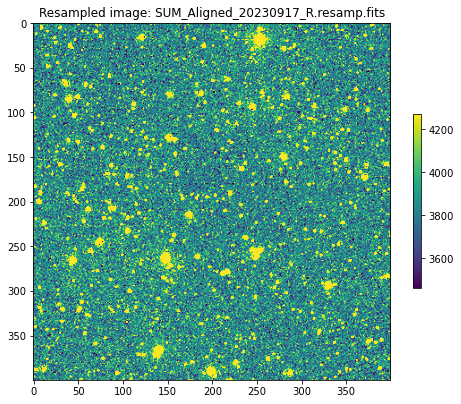

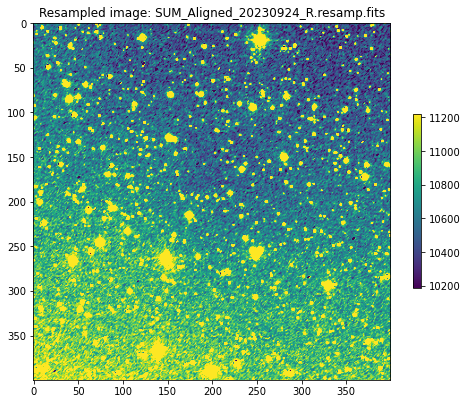

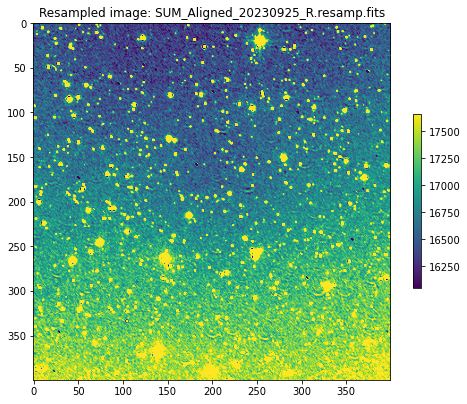

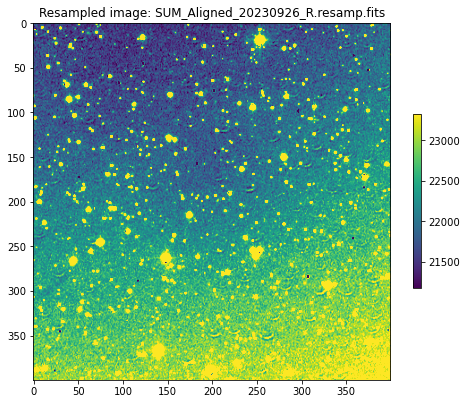

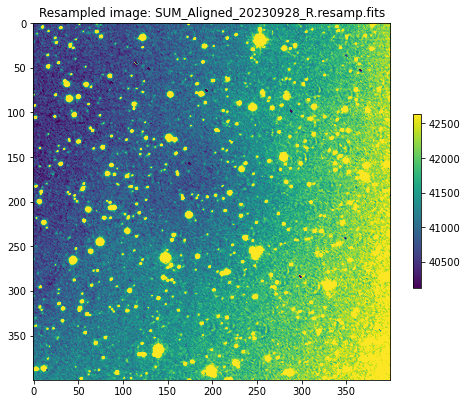

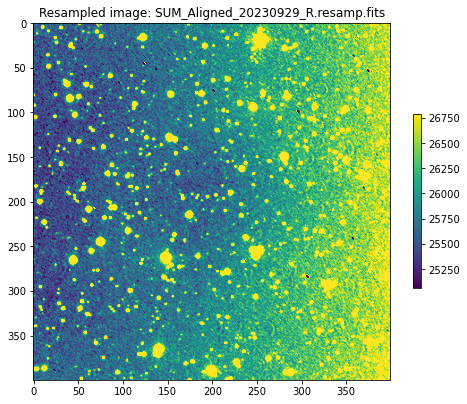

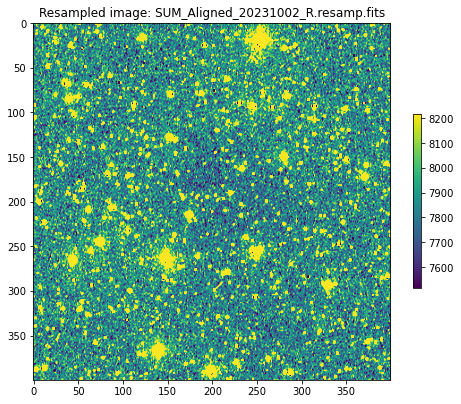

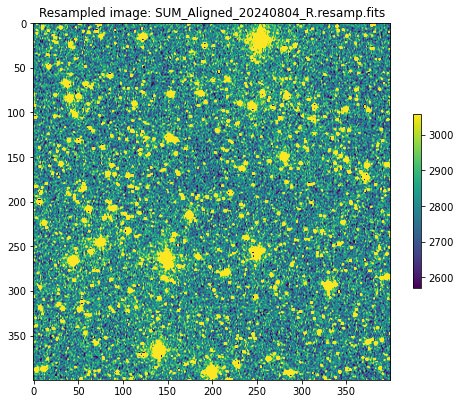

In [9]:
for i in range(len(align_image_array)):
    image = fits.open(align_image_array[i])
    mean, median, std = sigma_clipped_stats(image[0].data)
    plt.figure(figsize=(8,8))

    # set the scale of the image based on its statistics
    # Name looks totally wrong!
    plt.imshow(image[0].data, vmin=median-2*std, vmax=median+2*std)
    plt.colorbar(shrink = 0.4)
    plt.title('Resampled image: '+align_image_array[i])
    plt.show()



# Background Subtraction
- Mask sources in images
- Use 3 sigma clipping to filter data and accurately measure the backgorund
- Then split image into 300x300 pixel boxes and apply 2x2 median filter

That was the original. We are going to (for the first image)

1) look at the scalar background (for no good reason!)
2) look at the 2D background with no mask
3) look at the 2D background a mask

And then assume (3) is best and go ahead with subtracting them all!

Note that the final background subtraction is skipped if the flag indicating that it should already have
happened during the resampling step is set to 1!

In [10]:
# Let's loop through the images and check the essential statistics on each background.

sigma_clip = SigmaClip(sigma=3.0, maxiters=20) # parameters for estimation
footprint = circular_footprint(radius=rad) #size of source subtraction?
print("Mean, Median, and Standard Deviation for the background in each image\n\n")
for i in range(len(align_image_array)):
    image = fits.open(align_image_array[i])
    # Eventually do this for each image in the array.
    #image = sci_image_aligned # remove for multi image!
    #image = fits.open(align_image_array[0])
    hdr = image[0].header #save fits header
    threshold = detect_threshold(image[0].data, nsigma=2.0, sigma_clip=sigma_clip)
    segment_img = detect_sources(image[0].data, threshold, npixels=10)
    
    # This next line fails sometimes, so let's put in some debugging
    #plt.imshow(segment_img, origin='lower', cmap=segment_img.cmap,interpolation='nearest')
    #plt.colorbar()
    #plt.show()
    
    mask = segment_img.make_source_mask(footprint=footprint)
    mean, median, std = sigma_clipped_stats(image[0].data, sigma=3.0, mask=mask)
    print((mean, median, std))  

Mean, Median, and Standard Deviation for the background in each image


(3857.5393, 3855.7556, 197.06824)
(10635.6045, 10623.996, 231.71245)
(16794.004, 16750.031, 369.1942)
(22168.059, 22117.855, 481.69513)
(41245.188, 41189.45, 533.06604)
(25819.66, 25771.16, 357.09326)
(7848.6313, 7846.2417, 165.9757)
(2803.266, 2801.8923, 114.48636)


I guess just look for outliers....

2D background estimator (50x50 box, 3x3 median filter). Look and decide on using masked vs unmasked based on the first image - we'll see all the results later.

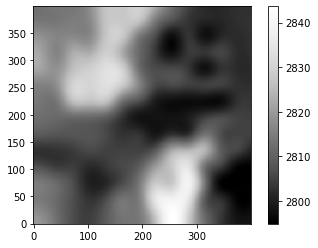

In [11]:
bkg_estimator = MedianBackground()
sigma_clip = SigmaClip(sigma=3.0)
bkg = Background2D(image[0].data, (bg_size,bg_size), filter_size=(filter_size, filter_size),sigma_clip=sigma_clip, bkg_estimator=bkg_estimator)
plt.imshow(bkg.background, origin='lower', cmap='Greys_r',interpolation='nearest')
plt.colorbar()

But this is unmasked, and it does look like the stars are impacting the background. So let's try the same with a mask.

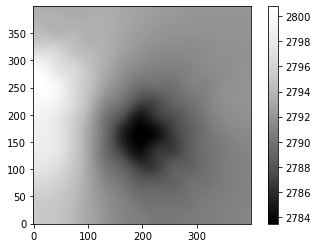

In [12]:
bkg = Background2D(image[0].data, (bg_size,bg_size), filter_size=(filter_size, filter_size),sigma_clip=sigma_clip, bkg_estimator=bkg_estimator,mask=mask)
plt.imshow(bkg.background, origin='lower', cmap='Greys_r',interpolation='nearest')
plt.colorbar()

So actually, sometimes the unmasked background here looks *better*, at least with this first image. So I'm going to set a flag to decide which background to use. This should probably be set to default to the masked, however!

Subtracting background with a mask...
Mean, Median, and Standard Deviation for the background


(2.8827547241469773, 1.4340144763123135, 196.82275642666252)
Writing background subtracted file SUM_Aligned_20230917_R_bkgsub.fits 
Subtracting background with a mask...
Mean, Median, and Standard Deviation for the background


(115.77151393953737, 103.84036918865513, 211.1085832493115)
Writing background subtracted file SUM_Aligned_20230924_R_bkgsub.fits 
Subtracting background with a mask...
Mean, Median, and Standard Deviation for the background


(118.0709623872317, 97.64733218416768, 244.81695721991665)
Writing background subtracted file SUM_Aligned_20230925_R_bkgsub.fits 
Subtracting background with a mask...
Mean, Median, and Standard Deviation for the background


(71.68642297712529, 53.70465708327902, 253.19873806450536)
Writing background subtracted file SUM_Aligned_20230926_R_bkgsub.fits 
Subtracting background with a mask...
Mean, Median, and Standard Deviation for the background

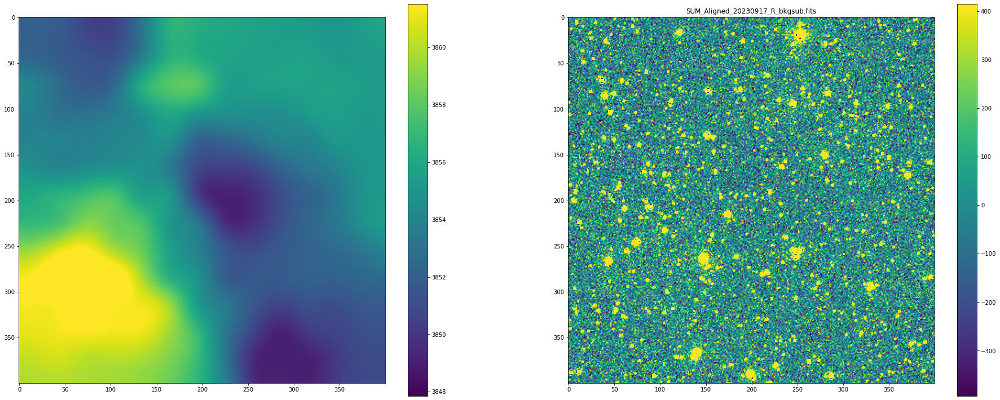

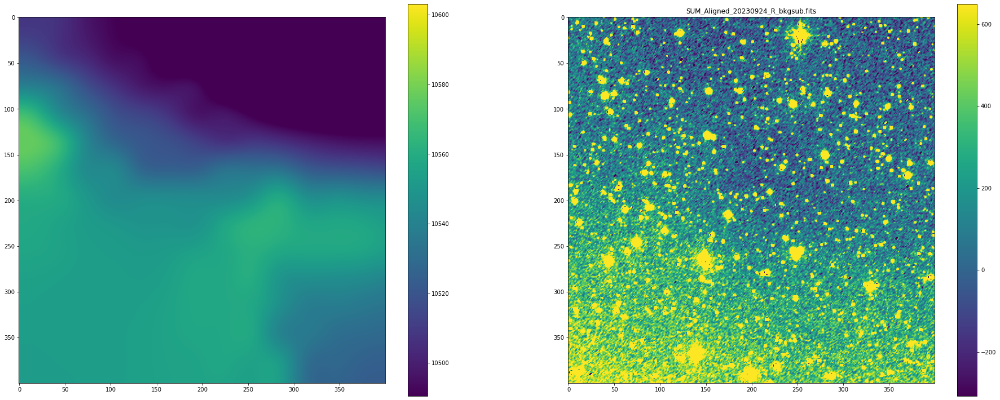

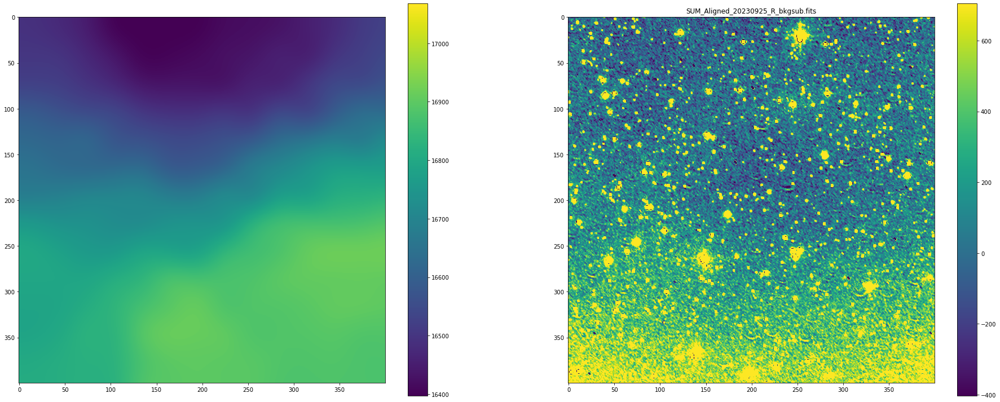

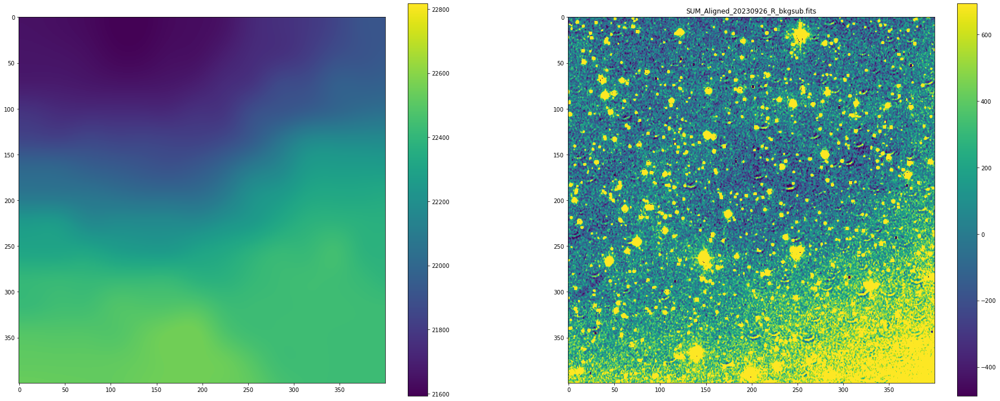

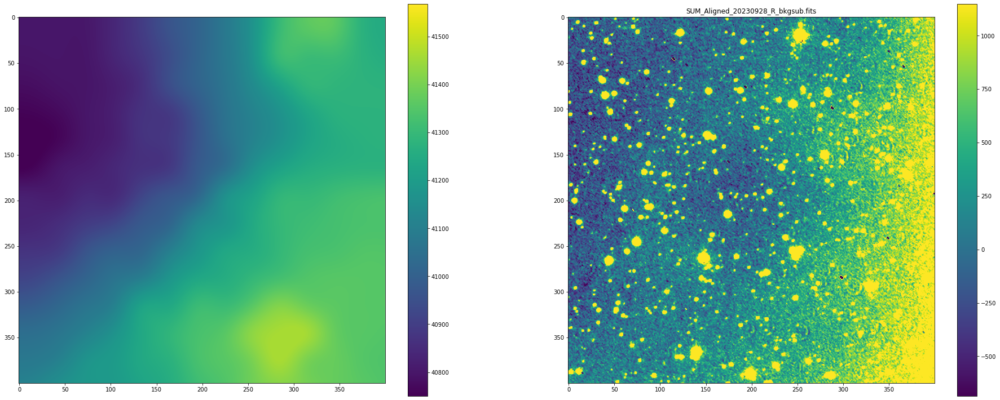

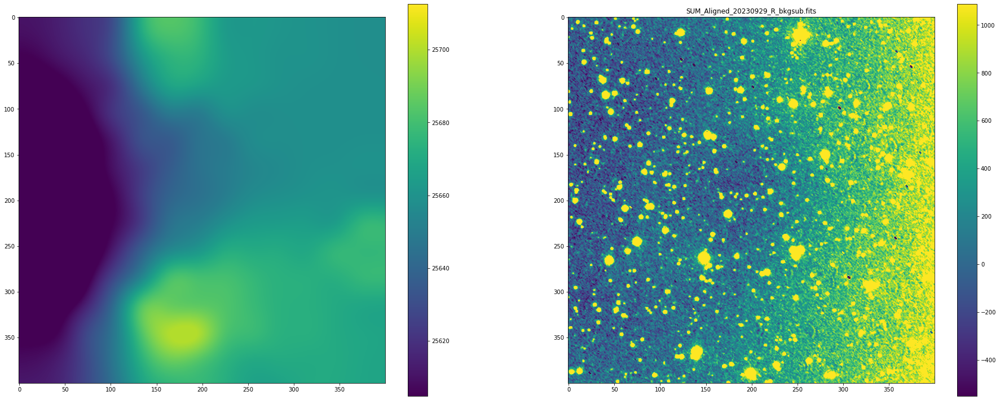

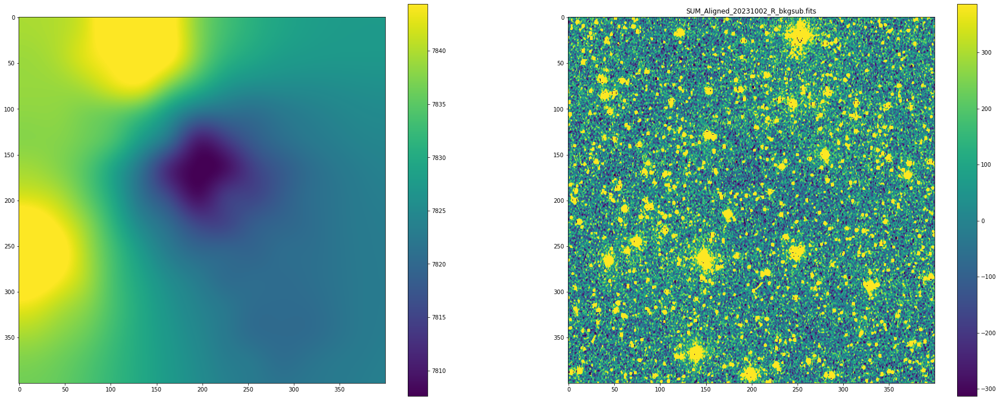

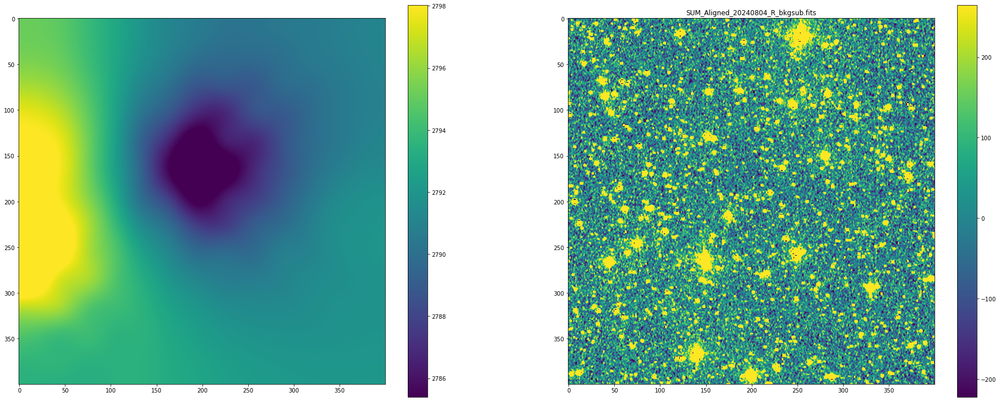

In [13]:
# Do this for each image in the array.
bkg_subtract_array=[]
for i in range(len(align_image_array)):
    image = fits.open(align_image_array[i])
    hdr = image[0].header #save fits header
    
    # Basic background set up.
    bkg_estimator = MedianBackground()
    sigma_clip = SigmaClip(sigma=bkg_sigma_clip)
    threshold = detect_threshold(image[0].data, nsigma=bkg_sigma_thresh, sigma_clip=sigma_clip)
    
    # get source mask individually for each image (didn't have to do this on ctn!)
    if bg_mask_flag==1:
        # get source mask individually for each image (didn't have to do this on ctn!)
        print("Subtracting background with a mask...")
        segment_img = detect_sources(image[0].data, threshold, npixels=10)
        mask = segment_img.make_source_mask(footprint=footprint) # mask too big once?
        # sometimes need to evaluate the mask...
        #print(mask.sum())
        # measure and subtract the background
        # note this exclude_percentile is default 10, and more means more exclusions. From the Docs, "For best results, 
        # exclude_percentile should be kept as low as possible ", although increasing has fixed a few errors.
        bkg = Background2D(image[0].data, (bg_size,bg_size), filter_size=(filter_size,filter_size),\
                       sigma_clip=sigma_clip, bkg_estimator=bkg_estimator,mask=mask,exclude_percentile=10.0)
    if bg_mask_flag==0:
        # use unmasked background.
        print("Subtracting background without a mask...")
        bkg = Background2D(image[0].data, (bg_size,bg_size), filter_size=(filter_size, filter_size),sigma_clip=sigma_clip, bkg_estimator=bkg_estimator)

    # write background file
    bkg_subtract_name=align_image_array[i].replace(".resamp.fits", "_bkgsub.fits")
    bkg_subtract_array.append(bkg_subtract_name)
    if bg_subtract_pre_resamp_flag==0: # do this background subtraction...
        image[0].data = image[0].data - bkg.background
    elif bg_subtract_pre_resamp_flag==1: # don't do it, it's already been done!
        print("Background subtraction already happened during resampling step!\n")
    hdu_image_sub = fits.PrimaryHDU(image[0].data,image[0].header) #added headers! Includes SAT level!
    hdu_image_sub.writeto(bkg_subtract_name,overwrite=True)
    
    print("Mean, Median, and Standard Deviation for the background\n\n")
    mean, median, std = sigma_clipped_stats(image[0].data, sigma=3.0, mask=mask)
    print((mean, median, std))  
    print("Writing background subtracted file",bkg_subtract_name,"\n===============================================")
    #plotting for evaluation
    fig, axs = plt.subplots(1, 2,figsize=(32,32)) # could add figsize command...
    plt.title(bkg_subtract_name)
    mean, median, std = sigma_clipped_stats(bkg.background)
    pcm=axs[0].imshow(bkg.background, vmin=median-2*std, vmax=median+2*std)
    plt.colorbar(pcm,ax=axs[0],shrink=0.4)
    mean, median, std = sigma_clipped_stats(image[0].data)
    pcm=axs[1].imshow(image[0].data, vmin=median-2*std, vmax=median+2*std)
    plt.colorbar(pcm,ax=axs[1],shrink=0.4)

These images look right in AIJ, but I did get an error that these images are now double precision, whereas AIJ expects single precision. Fine for now?

In [14]:
bkg_subtract_array

['SUM_Aligned_20230917_R_bkgsub.fits',
 'SUM_Aligned_20230924_R_bkgsub.fits',
 'SUM_Aligned_20230925_R_bkgsub.fits',
 'SUM_Aligned_20230926_R_bkgsub.fits',
 'SUM_Aligned_20230928_R_bkgsub.fits',
 'SUM_Aligned_20230929_R_bkgsub.fits',
 'SUM_Aligned_20231002_R_bkgsub.fits',
 'SUM_Aligned_20240804_R_bkgsub.fits']

## PSF matching

The atmosphere heavily affects the PSF of the images by determining the "seeing" conditions. The seeing for ground-based optical telescopes is usually measured as the FWHM of the imaging PSF.  Properties of the atmosphere can change very rapidly, so it is rare that science and reference images are characterized by the same seeing. Therefore their PSFs are usually different, which is a problem for image subtraction. 


### Generate the kernel for the convolution

The PSF of the science and reference images can be matched in several different ways.  Here we start by performing a first source extraction on the reference image (which we assume to be the last in the list).  We can use the catalogs of sources that we obtain for two main purposes: <br />
1. Measure the PSF of the science reference frame, using PSFex or photutils
2. Obtain instruments magnitudes that will be the basis for the zero-point calibration (see Photometry module).  


In [15]:
def mask_function(mask,x,y,radius):
    for i in range(-(radius-1),radius):
        for j in range(abs(i)-(radius-1),radius-abs(i)):
            #print(x+i,y+j)
            mask[x+i][y+j]=True
    return(mask)

In [16]:
# Block for masking out the saturated stars.

if sat_mask_flag==1:
    for i in range(len(bkg_subtract_array)):
        # grab the saturation level ...
        file_name=os.path.join(proc_dir, bkg_subtract_array[i])
        # get saturation level
        image = fits.open(file_name) # only need open to read the header
        SAT=image[0].header['SATURATE']
        print("Saturation level",SAT)
        # Check histogram?
        #mean, median, std = sigma_clipped_stats(image[0].data)
        #plt.imshow(image[0].data,vmin=median-2*std,vmax=median+2*std)
        #plt.show()
        #hist_data=(image[0].data).flatten()
        #print(hist_data.shape,(image[0].data).shape)
        #plt.hist(hist_data, bins=1000,range=(0,40000))
        #plt.show()

        
        # No, this block needs to mask out a CIRCLE around the saturated source, otherwise we get those missing
        # black spots in the PSF...
        # try to use the existing code as much as possible...
        
        
        # set the threshhold to like 80% of that level....
        limit=SAT_FRAC*SAT
        # use segment images to mask the sources which have any pixels over that 80% level...
        # 1 connected pixels greater than the limit. Not that a larger value here means LESS masking.
        # npixels=4 worked before, but found nothing in B filter...
        segment_map = detect_sources(image[0].data, limit, npixels=pixmask)
        #print(segment_map)
        #plt.imshow(segment_map, cmap=segment_map.cmap,interpolation='nearest')
        #plt.show()
        # ...
        # profit?
        if (segment_map == None): # if there are no saturated sources, skip this!
            masked_image=image[0].data
            print("No saturated sources found")
        else:
            mask_bool=segment_map.make_source_mask()
            # Walk over the segment map and create a mask with stars masked around each saturated star.
            for j in range(image[0].shape[0]):
                for k in range(image[0].shape[1]):
                    if segment_map.data[j][k]==1:
                        #print("Found a source!",j,k)
                        mask_function(mask_bool,j,k,stamp_rad) # this thing will mask out a stamp of the right radius
                        
            #mask_bool=segment_map.make_source_mask()
            masked_image=np.where(mask_bool==False,image[0].data,np.NaN)
        #mean, median, std = sigma_clipped_stats(masked_image)
        #plt.imshow(masked_image,vmin=median-2*std,vmax=median+2*std)

        fig, axs = plt.subplots(1, 2,figsize=(16,16)) # could add figsize command...
        plt.title(file_name)
        mean, median, std = sigma_clipped_stats(mask_bool)
        pcm=axs[0].imshow(mask_bool, vmin=median-2*std, vmax=median+2*std)
        plt.colorbar(pcm,ax=axs[0],shrink=0.4)
        mean, median, std = sigma_clipped_stats(masked_image)
        pcm=axs[1].imshow(masked_image, vmin=median-2*std, vmax=median+2*std)
        plt.colorbar(pcm,ax=axs[1],shrink=0.4)

        # now write the masked image to the original image location, so the names don't have to get messed around with.
        hdu_image_sub = fits.PrimaryHDU(masked_image,image[0].header) #added headers! Includes SAT level!
        hdu_image_sub.writeto(file_name,overwrite=True) # overwrite the files so we can continue without change.

else:
    print("Vanilla routine, saturated stars NOT masked")

Vanilla routine, saturated stars NOT masked


In [17]:
# Alternative routine to accomplish the above
# never implemented because which source_extract gives sturation flags, it doesn't play reasonably well with
# segmentation images we need for masking.

'''
if alt_sat_flag==1
# used flagged sources in catalog to get segment img of saturated sources.

# Set them to zero
for i in range(segment_img.shape[0]):
    for j in range(segment_img.shape[1]):
        if segment_img.data[i][j] != 0:
            image[0].data[i][j]=0
'''

'\nif alt_sat_flag==1\n# used flagged sources in catalog to get segment img of saturated sources.\n\n# Set them to zero\nfor i in range(segment_img.shape[0]):\n    for j in range(segment_img.shape[1]):\n        if segment_img.data[i][j] != 0:\n            image[0].data[i][j]=0\n'

In [18]:
# use REFERENCE image to extract sources.
# overwriting the catalog, but I guess that doesn't matter much.

#ref_image_bkgsub_name = ref_bkg_subtract_name # SWTICH when you go back to multi image!
ref_image_bkgsub_name = os.path.join(proc_dir, bkg_subtract_array[len(bkg_subtract_array)-1])

if os.path.exists('prepsfex.cat'): #Remove possible temporary files
    os.remove("prepsfex.cat") 

# get saturation level
ref_image_bkgsub = fits.open(ref_image_bkgsub_name) # only need open to read the header
SAT=ref_image_bkgsub[0].header['SATURATE']
print("Saturation level",SAT)
    
try:
    #command = "sextractor %s -c %s -CATALOG_NAME %s -MAG_ZEROPOINT 25.0" % (sci_image_aligned_name, os.path.join(data_dir, 'prepsfex.sex'), os.path.join(proc_dir, 'prepsfex.cat'))
    #command = "source-extractor %s -c %s -CATALOG_NAME %s -MAG_ZEROPOINT 25.0" % (sci_image_aligned_name, os.path.join(data_dir, 'prepsfex.sex'), os.path.join(proc_dir, 'prepsfex.cat'))
    command = "source-extractor %s -c %s -CATALOG_NAME %s -MAG_ZEROPOINT 25.0 -SATUR_LEVEL %s" % (ref_image_bkgsub_name, \
        os.path.join(data_dir,'prepsfex.sex'), os.path.join(proc_dir, 'prepsfex.cat'),SAT)
    print('Executing command: %s\n' % command)
    rval = subprocess.run(command.split(), check=True)
    print('Success!')
except subprocess.CalledProcessError as err:
    print('Could not run SExtractor with exit error %s'%err)

Saturation level 39938.6679459
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20240804_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459

Success!


In [19]:
#cat = fits.open("prepsfex.cat")
#cat_data = Table(cat[2].data)
#cat_data

Saturation filter pre-PSF, didn't do much so generally not used.

In [20]:
# look for saturation (ANY 4, even in another number, indicates a saturated pixel):
# But note from the docs:  https://sextractor.readthedocs.io/en/latest/Flagging.html these flags are
# "in order of increasing concern", so maybe the right is to filter out 4 AND HIGHER?
# Need the lines above for this!
'''
filter_sat=1 # 0 to NOT filter out saturation flags, 1 to YES filter for saturation flags.
j=0
for i in reversed(range(len(cat_data['FLAGS']))): #loop backwards so we can remove rows
    if cat_data['FLAGS'][i]==4:
        if filter_sat==1:
            cat_data.remove_row(i)
        j=j+1
    
j
'''

"\nfilter_sat=1 # 0 to NOT filter out saturation flags, 1 to YES filter for saturation flags.\nj=0\nfor i in reversed(range(len(cat_data['FLAGS']))): #loop backwards so we can remove rows\n    if cat_data['FLAGS'][i]==4:\n        if filter_sat==1:\n            cat_data.remove_row(i)\n        j=j+1\n    \nj\n"

From "Sextractor for dummies": https://arxiv.org/pdf/astro-ph/0512139

"SATUR LEVEL is the limit for SE to start extrapolating to get the photometry. However as
soon as you hit something as saturated as that you might want to see if there is another way to
determine the flux from that object."

So yes - it's just flagged. Good for catalog, but not good for any calculations!

PSFex: It seems to be ignoring ANY flagged sources, at least by default. I am going to change the parameter file, 

SAMPLE_MINSN       3            # Minimum S/N for a source to be used

To 20 (program default), and check the effect! No improvement! 50? Nothing! That's not the problem...

I guess take a look at the catalog...

In [21]:
'''
fig = plt.figure(figsize=(8,8))
#ax = fig.add_subplot(111)
plt.scatter(cat_data['X_IMAGE'], cat_data['Y_IMAGE'], facecolors='none', edgecolors='r', linewidths=0.5)
#image = fits.open(align_image_array[i])
mean, median, std = sigma_clipped_stats(ref_image_bkgsub[0].data)
plt.imshow(ref_image_bkgsub[0].data, vmin=median-2*std, vmax=median+2*std)
'''

"\nfig = plt.figure(figsize=(8,8))\n#ax = fig.add_subplot(111)\nplt.scatter(cat_data['X_IMAGE'], cat_data['Y_IMAGE'], facecolors='none', edgecolors='r', linewidths=0.5)\n#image = fits.open(align_image_array[i])\nmean, median, std = sigma_clipped_stats(ref_image_bkgsub[0].data)\nplt.imshow(ref_image_bkgsub[0].data, vmin=median-2*std, vmax=median+2*std)\n"

Now we use another software part of the AstrOmatic suite, PSFex, to **measure the PSF of the reference image**. PSFex estimates the PSF based on the information present in the catalog generated with SExtractor.  Then, let's plot the PSF model obtained with PSFex

Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/out/proto_prepsfex.fits



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:31 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     428 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                    36/37      1.00   2.84   1.78  0.04  0.03  0.02
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


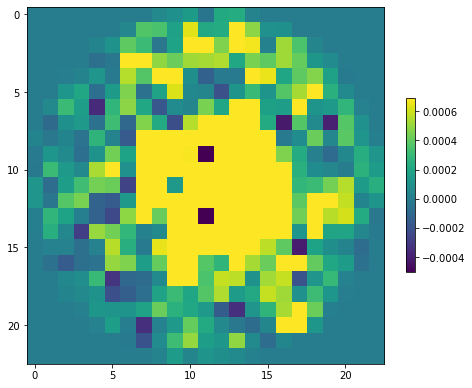

In [22]:
# Run PSFex to compute PSF, read and display the final model; needs to output to "out" dir.
if not os.path.isdir('out'): os.mkdir('out')

try:
    command = "psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=%s, %s -VERBOSE_TYPE=FULL" % (size_of_psf,size_of_psf)
    
    #command = "psfex %s -c %s" % (source_extract_cat_name,psfex_config_name)
    print('Executing command: %s\n' % command)
    rval = subprocess.run(command.split(), check=True)
    print('Success!')
except subprocess.CalledProcessError as err:
    print('Could not run psfex with exit error %s'%err)

psf_ref_image_name = os.path.join(out_dir,'proto_prepsfex.fits') # hard coded name from psfex?
print(psf_ref_image_name)
psf_ref_image = fits.open(psf_ref_image_name)

mean, median, std = sigma_clipped_stats(psf_ref_image[0].data[0])
plt.figure(figsize=(8,8))
plt.imshow(psf_ref_image[0].data[0], vmin=median-2*std, vmax=median+2*std)
plt.colorbar(shrink = 0.4)

cyx: (1.?) Another pretty bad PSF! Ok, but the median filtering helped! (1.6) hole in the middle? Fixed with a median on the reference, but still looks quite bad. Jesus finally, just screwing up WCS, B instead of I, etc.

koy: Seems reasonable.

### Convolve the science images with the PSF of the reference image

Now that the kernel is generated, let's convolve the science images with the PSF of the reference, to create our array of convolved science images.

/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230917_R_bkgsub_conv.fits


/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


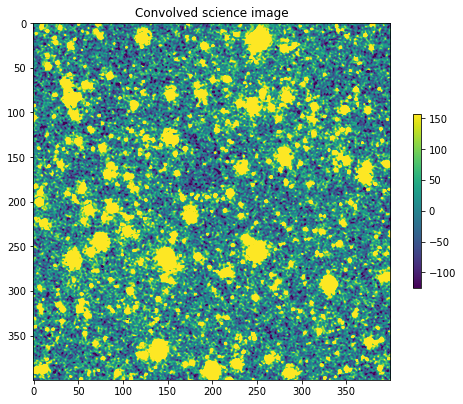

/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230924_R_bkgsub_conv.fits


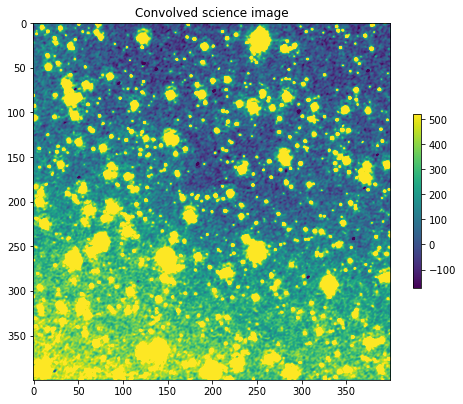

/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230925_R_bkgsub_conv.fits


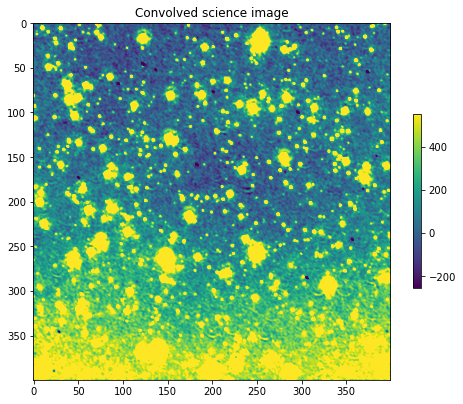

/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230926_R_bkgsub_conv.fits


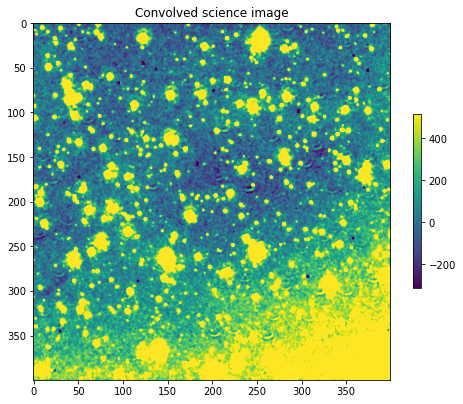

/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230928_R_bkgsub_conv.fits


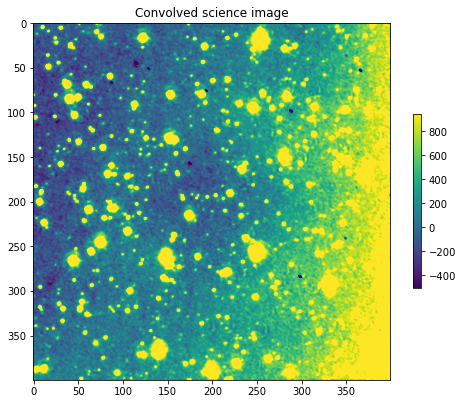

/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230929_R_bkgsub_conv.fits


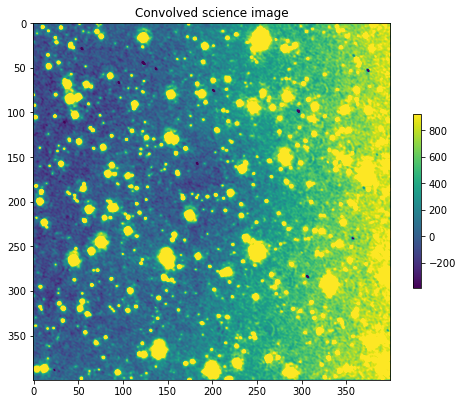

/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20231002_R_bkgsub_conv.fits


/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/4043650421.py:16: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step


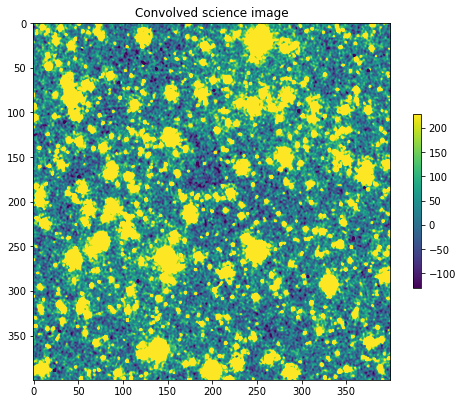

In [23]:
# Convolve the kernel of the reference image PSF with each science frame
kernel_ref = psf_ref_image[0].data[0]

# for plotting
#fig, axes = plt.subplots(3, math.ceil(len(bkg_subtract_array)/3.))
#plt.figure(figsize=(4,4))

sci_conv_array=[]
for i in range(len(bkg_subtract_array)-1): # don't need to do the last one, that's reference
    sci_bkg_subtract = fits.open(bkg_subtract_array[i])
    if sat_mask_flag==1: # can't do "fft" method, I guess! 
        sci_conv=convolve(sci_bkg_subtract[0].data, kernel_ref)
        # scipy convolve copies all the NaNs into the convolution.
        #sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='direct')
    else:
        sci_conv = scipy_convolve(sci_bkg_subtract[0].data, kernel_ref, mode='same', method='fft') # convolve step
    hdu_sci_conv = fits.PrimaryHDU(sci_conv,sci_bkg_subtract[0].header) # really should be adding header keys!
    sci_conv_array.append(bkg_subtract_array[i].replace(".fits","_conv.fits"))
    sci_conv_name=os.path.join(proc_dir,sci_conv_array[i])
    
    # Write the images
    print(sci_conv_name)
    hdu_sci_conv.writeto(sci_conv_name,overwrite=True)

    #Plot up the convolved reference image
    mean, median, std = sigma_clipped_stats(hdu_sci_conv.data)
    plt.figure(figsize=(8,8))

    # set the scale of the image based on its statistics
    # Name looks totally wrong!
    plt.imshow(hdu_sci_conv.data, vmin=median-2*std, vmax=median+2*std)
    plt.colorbar(shrink = 0.4)
    plt.title('Convolved science image')
    plt.show()

Next step is actually to create a corresponding refernce image for each science image, which is the reference convolved with the science. Then each pair should have the same PSF.

In [24]:
sci_conv_array

['SUM_Aligned_20230917_R_bkgsub_conv.fits',
 'SUM_Aligned_20230924_R_bkgsub_conv.fits',
 'SUM_Aligned_20230925_R_bkgsub_conv.fits',
 'SUM_Aligned_20230926_R_bkgsub_conv.fits',
 'SUM_Aligned_20230928_R_bkgsub_conv.fits',
 'SUM_Aligned_20230929_R_bkgsub_conv.fits',
 'SUM_Aligned_20231002_R_bkgsub_conv.fits']

### Convolve the reference image with the PSF of each science image


Same as above, but this time we generate a kernel with the properties of the **PSF of the science images**.  Then, we convolve the reference image with this kernel, once for each science image. This creates the array of convolved reference images, which are needed to subtract from the science frames.

I think what is happening here is the PSF data is stored in prepsfex.cat, as an output catalog from source-extractor, so we need to re-run the source extractor to get the PSF of the image in question. 

Kernel from *each* science image

Maybe what needs to go here is a way to CLEAN the catalogs, removing sources that are clearly saturated, so they are not used in the normalization routine?


During this step, I once got an error (on sse) not finding sources with appropriate FWHM...I fixed that by adding -DETECT_MINAREA 1 to the source-extractor command (default 5), or -DETECT_THRESH 3...the second one looked a bit better. Basically, the seeing was just *too good* for that night! That's this line in the 3rd box wwwaaayyy above:

extract_thresh=5 # Threshhold for detection above sigma - default 5


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230917_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 39882.27910233
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230917_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39882.27910233 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:32 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     405 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                    52/53      1.00   1.15   1.80  0.07  0.03  0.02
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


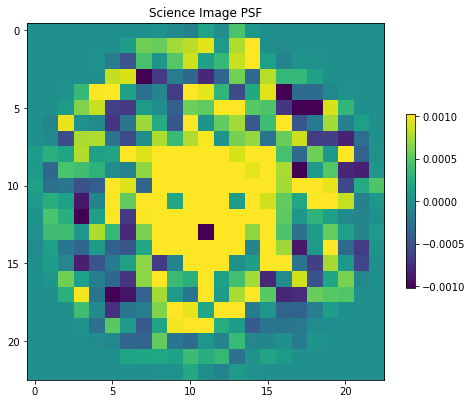

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230917_R_bkgsub_refconv.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


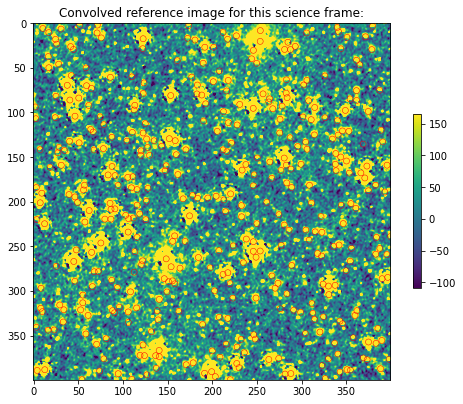


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230924_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 39974.2533542
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230924_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39974.2533542 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:33 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     667 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                    60/73      1.00   1.02   1.75  0.03  0.02  0.03
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


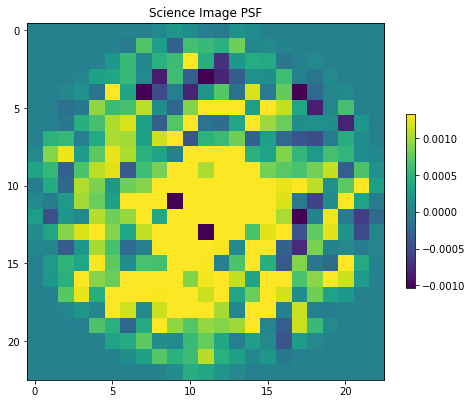

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230924_R_bkgsub_refconv.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


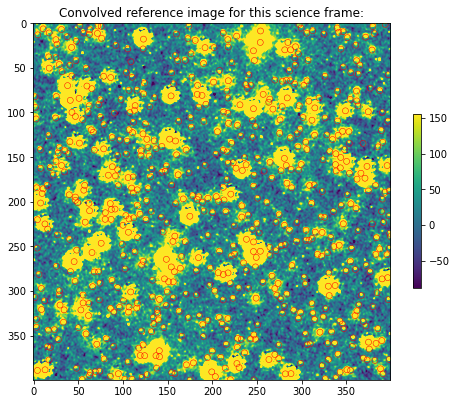


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230925_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 40099.82762688
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230925_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40099.82762688 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:33 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     667 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                    49/55      1.00   1.21   1.81  0.04  0.03  0.03
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


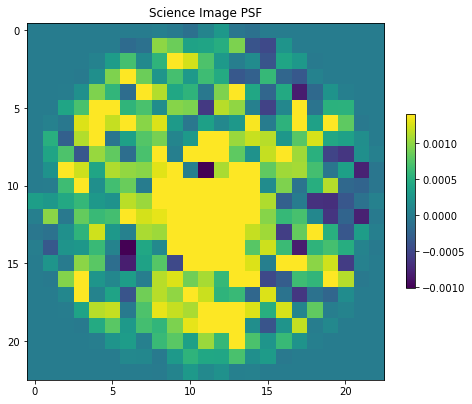

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230925_R_bkgsub_refconv.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


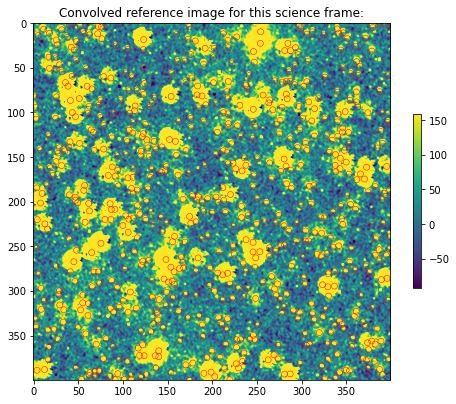


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230926_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 40025.77308729
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230926_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40025.77308729 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:33 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     607 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                    70/86      1.00   1.00   1.81  0.02  0.02  0.03
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


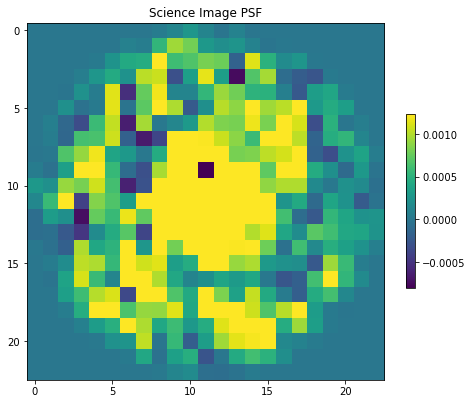

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230926_R_bkgsub_refconv.fits


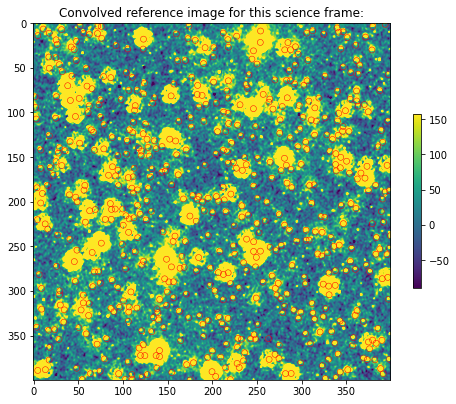


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230928_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 40082.02577786
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230928_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40082.02577786 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:34 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     502 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                   203/217     1.00   0.94   2.04  0.08  0.03  0.07
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


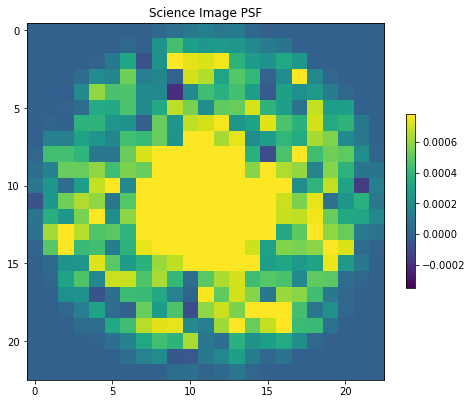

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230928_R_bkgsub_refconv.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


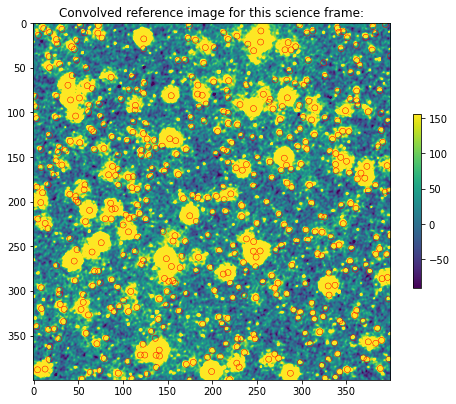


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230929_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 40066.66018009
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230929_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40066.66018009 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL




> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:35 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     527 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                   238/255     1.00   0.90   2.08  0.04  0.02  0.02
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


Success!


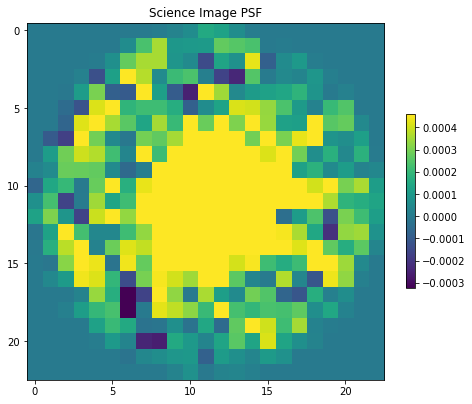

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20230929_R_bkgsub_refconv.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


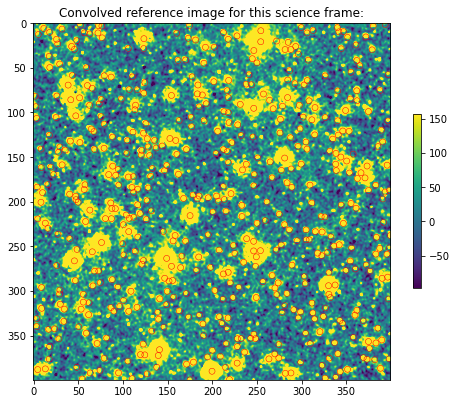


This Image info:
Filename: /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20231002_R_bkgsub.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      56   (400, 400)   float64   
Saturation level 39958.93819679
Executing command: source-extractor /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20231002_R_bkgsub.fits -c /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/data/prepsfex.sex -CATALOG_NAME /media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/prepsfex.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39958.93819679 -DETECT_THRESH 2

Success!
Executing command: psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=23, 23 -VERBOSE_TYPE=FULL

Success!



> WARNING: NTHREADS != 1 ignored: this build of PSFEx is single-threaded

.
----- PSFEx 3.17.1 started on 2025-02-10 at 18:04:35 with 1 thread

.
----- 1 input catalogues:
prepsfex.cat        :  "AT2023sse       "    1 extension     662 detections

Initializing contexts....
Reading data from prepsfex....
Computing final PSF model for prepsfex....
Computing diagnostics for prepsfex....
prepsfex                    67/76      1.00   1.16   1.80  0.06  0.02  0.02
Saving CHECK-image #1....
Saving CHECK-image #2....
Saving CHECK-image #3....
Saving CHECK-image #4....
Saving CHECK-image #5....
Saving CHECK-image #6....
Saving CHECK-image #7....
Saving CHECK-image #8....
Saving PSF model and metadata for prepsfex....
Computing homogenisation kernel for prepsfex....

*** PLPLOT WARNING ***
Driver does not support hardware solid fills, switching to software fill.

Writing XML file....
.


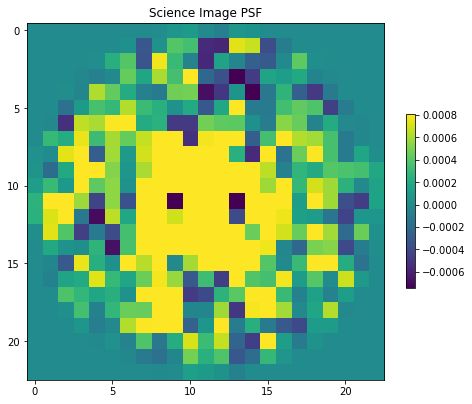

Check: Reference image here is SUM_Aligned_20240804_R_bkgsub.fits
/media/cduston/MCARG/AnalyzedSources/AT2023sse/image_subtraction/processed/SUM_Aligned_20231002_R_bkgsub_refconv.fits


/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f8 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
/tmp/ipykernel_26811/2444261187.py:65: DeprecationWarning: dtype=>f4 is not supported by correlate and will raise an error in SciPy 1.17.0. Supported dtypes are: boolean, integer, `np.float16`,`np.float32`, `np.float64`, `np.complex64`, `np.complex128`.
  ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step


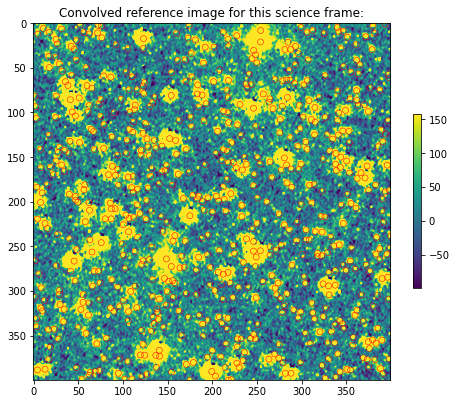

In [25]:
ref_conv_array=[]
for i in range(len(bkg_subtract_array)-1): # don't need to do the last one, that's the reference
    sci_image_bkgsub_name = os.path.join(proc_dir, bkg_subtract_array[i])
    sci_image_bkgsub = fits.open(sci_image_bkgsub_name) # only need open to read the header
    print("=======================================================\n\nThis Image info:") # for debugging
    sci_image_bkgsub.info() # for debugging

    try:
        # prepsfex.sex is the config file
        # prepsfex.cat is a binary output file, gets rewriten each time.
        # let's try to put the saturation level into this command.
        # didn't fix anything!
        # BACK_SIZE also doesn't seem to help this problem.
        SAT=sci_image_bkgsub[0].header['SATURATE']
        print("Saturation level",SAT)
        command = "source-extractor %s -c %s -CATALOG_NAME %s -MAG_ZEROPOINT 25.0 -SATUR_LEVEL %s -DETECT_THRESH %s" % (sci_image_bkgsub_name, \
            os.path.join(data_dir,'prepsfex.sex'), os.path.join(proc_dir, 'prepsfex.cat'),SAT,extract_thresh)
        
        print('Executing command: %s\n' % command)
        rval = subprocess.run(command.split(), check=True)
        print('Success!')
    except subprocess.CalledProcessError as err:
        print('Could not run SExtractor with exit error %s'%err)
     
    # Run PSFex to compute PSF, read and display the final model; needs to output to "out" dir.
    if not os.path.isdir('out'): os.mkdir('out') # should be made already

    try:
        # prepsfex.cat is the binary file created in the last step.
        # psfex_conf.psfex is config file, used each time.
        
        # can I filter out the saturated sources here, so they are not used for finding the PSF?
        
        command = "psfex prepsfex.cat -c psfex_conf.psfex -PSF_SIZE=%s, %s -VERBOSE_TYPE=FULL" % (size_of_psf,size_of_psf)
        print('Executing command: %s\n' % command)
        rval = subprocess.run(command.split(), check=True)
        print('Success!')
    except subprocess.CalledProcessError as err:
        print('Could not run psfex with exit error %s'%err)

    psf_sci_image_name = os.path.join(out_dir,'proto_prepsfex.fits') # hard coded name
    #psf_sci_image_name = os.path.join(out_dir,bkg_subtract_array[i].replace('.fits','_protoPSF.fits')) # rewriting each time!
    #print(psf_sci_image_name)
    psf_sci_image = fits.open(psf_sci_image_name)
    # only the last image shows...
    mean, median, std = sigma_clipped_stats(psf_sci_image[0].data[0])
    plt.figure(figsize=(8,8))
    plt.imshow(psf_sci_image[0].data[0],   vmin=median-2*std, vmax=median+2*std)  
    plt.colorbar(shrink = 0.4)
    plt.title('Science Image PSF')
    plt.show()   
        
    # Convolve the reference image PSF with the Pof each science frame
    # Grab the kernel!
    kernel_sci = psf_sci_image[0].data[0]
    
    # careful naming scheme needed!
    ref_bkg_subtract = fits.open(bkg_subtract_array[len(bkg_subtract_array)-1]) # REFERENCE IS LAST IMAGE!
    print("Check: Reference image here is",bkg_subtract_array[len(bkg_subtract_array)-1])
    if sat_mask_flag==1: # can't do "fft" method, I guess!
        ref_conv=convolve(sci_bkg_subtract[0].data, kernel_sci)
        # scipy convolve copies all the NaNs into the convolution.
        #ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='direct') # convolve step
    else:
        ref_conv = scipy_convolve(ref_bkg_subtract[0].data, kernel_sci, mode='same', method='fft') # convolve step
    
    hdu_ref_conv = fits.PrimaryHDU(ref_conv,ref_bkg_subtract[0].header) # header keys don't super matter...but from the reference!
    
    # yikes, this has to be named CAREFULLY!
    ref_conv_array.append(bkg_subtract_array[i].replace(".fits","_refconv.fits"))
    ref_conv_name=os.path.join(proc_dir,ref_conv_array[i])
    
    # Create the images
    print(ref_conv_name)
    hdu_ref_conv.writeto(ref_conv_name,overwrite=True)

    #Plot up the convolved reference image
    mean, median, std = sigma_clipped_stats(hdu_ref_conv.data)
    plt.figure(figsize=(8,8))

    # include the catalog
    cat = fits.open("prepsfex.cat")
    cat_data = Table(cat[2].data)
    plt.scatter(cat_data['X_IMAGE'], cat_data['Y_IMAGE'], facecolors='none', edgecolors='r', linewidths=0.5)
    
    # set the scale of the image based on its statistics
    plt.imshow(ref_conv, vmin=median-2*std, vmax=median+2*std)
    plt.colorbar(shrink = 0.4)
    plt.title('Convolved reference image for this science frame:')
    plt.show()    

Checking in AIJ, the resulting images have nearly the same PSF! (checking a few example sources, and they even seem to have the same pixel location values, which is good for us!

bright stars do have halos, which might be screwing up the background calculation, or the PSF? If we are eventually going to just subtract a circle, this might not matter.

In [26]:
ref_conv_array

['SUM_Aligned_20230917_R_bkgsub_refconv.fits',
 'SUM_Aligned_20230924_R_bkgsub_refconv.fits',
 'SUM_Aligned_20230925_R_bkgsub_refconv.fits',
 'SUM_Aligned_20230926_R_bkgsub_refconv.fits',
 'SUM_Aligned_20230928_R_bkgsub_refconv.fits',
 'SUM_Aligned_20230929_R_bkgsub_refconv.fits',
 'SUM_Aligned_20231002_R_bkgsub_refconv.fits']

### Improving the alignment
Now that the science image is convolved with (an approximation of) the PSF of the reference image, 
and the reference image is convolved with the PSF of the science image, we can perform the image subtraction.

- Before the subtraction we use an fft method (chi_2_shift) to fine-tune the image alignment of the reference and science image. We'll do this in pairs, reference aligning with science. When we go do photometry with AIJ, this fine tuning doesn't matter so much.

## Normalization and Subtraction of the images

The science and reference images are usually obtained with different exposure times.  In addition, the reference image can be the stack of several images to increase the depth.  Finally, different CCDs of the same camera (or even different regions of the same CCD when multiple amplifiers are present) may have slightly different gain. <br >

The background subtraction should have removed the non-linear offsets between science and reference images.  We can therefore normalize the two images by computing the ratio of bright star fluxes in the two images. Once again, we use SExtractor to extract the flux and other quantities.

We should be able to do this pairwise as well, as the offsets between different science images should be taken care of with our differential photometry. So we'll maybe normalize the reference(s) to the science?

Adding a catalog filter here, to get rid of things with flags over 4.

Have several other types of filters (and debugging info) down there, but no evidence that any of them actually helps anything!

In [27]:
# this here function will find the barycenter of each souce in the segment map and return them all.
# I think x and y are switched here and probably in everything else!
def find_barycenter(segment_map):
    index=[]
    for n in range(segment_map.nlabels):
        xCM=0
        x_no=0
        yCM=0
        y_no=0
        for i in range(len(segment_map.data)):
            for j in range(len(segment_map.data[i])):
                if segment_map.data[i][j] == segment_map.labels[n]:
                    xCM+=i
                    x_no+=1
                    yCM+=j
                    y_no+=1
        #print(xCM/x_no,yCM/y_no)
        index.append([xCM/x_no,yCM/y_no])
    print("sources found at barycenters:",index)
    return index
                    

In [28]:
# cleaning - do this before matching, I think.
# Catalog expected is catalog filename from sextractor.
# Nah, I think this has to be done as ASCII to match the rest of the code!
# Maybe read it in twice - once to get the header (as "basic"), and once to get the data (as "sextractor").
# For the flags we need the sextractor format, while for the data we need ascii.
# so we will probably have to write as ascii....or correlate the rows between the two?
def clean_cat(catalog):
    cat_sci_sex = ascii.read(catalog,format='sextractor')
    cat_sci_basic = ascii.read(catalog,format='no_header') 
    print("Initial catalog length: ",len(cat_sci_sex),",",len(cat_sci_basic)," (for debug, should be the same!)")
    j=0
    for i in reversed(range(len(cat_sci_sex))): #loop backwards in sextractor catalog so we can remove rows
        if cat_sci_sex['FLAGS'][i]>=4:
            cat_sci_basic.remove_row(i) # remove the row in the basic catalog
        if cat_sci_sex['FLUX_AUTO'][i]<=0: # remove if flux drops below zero
            cat_sci_basic.remove_row(i) # remove the row in the basic catalog
        j=j+1
        #print(j)
    print("Filtered down to length:", len(cat_sci_basic))
    cat_sci_basic.write(catalog,overwrite=True,format='ascii.no_header') # hope the headers get written?

In [29]:
# this here function will identify which source number in the segment map is closest to the last one found
def find_source_index(segment_map,last_source_bary):
    index_list=find_barycenter(segment_map)
    # distance to the first....
    dist=(last_source_bary[0]-index_list[0][0])**2+(last_source_bary[1]-index_list[0][1])**2
    print("distance debug:",last_source_bary[0],index_list[0][0],last_source_bary[1],index_list[0][1],dist)
    source_no_res=1
    for n in range(1,len(index_list)):
        dist1=(last_source_bary[0]-index_list[n][0])**2+(last_source_bary[1]-index_list[n][1])**2
        print(n,dist,dist1,source_no_res)
        if dist1 < dist:
            dist = dist1
            source_no_res=n+1
    return source_no_res,index_list[source_no_res-1]

In [30]:

from photutils.segmentation import SegmentationImage

Saturation level on Science: 39882.27910233
Executing command: source-extractor SUM_Aligned_20230917_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39882.27910233 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  472 , 472  (for debug, should be the same!)
Filtered down to length: 394
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20230917_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  653 , 653  (for debug, should be the same!)
Filtered down to length: 525


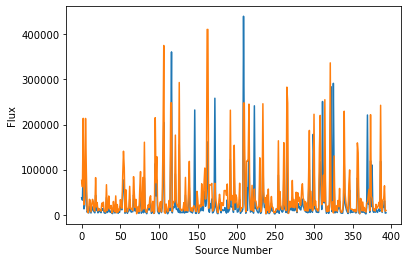

removing... (array([146, 299, 325]),)


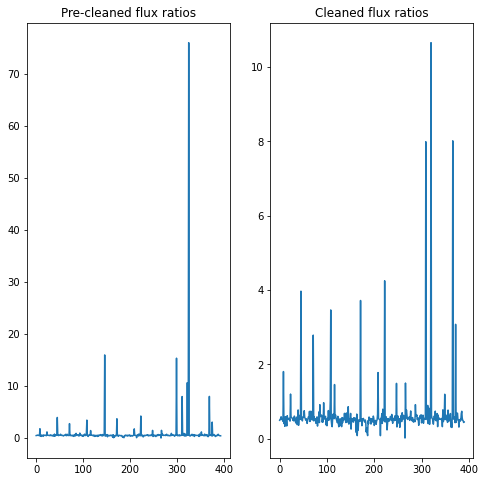

The scaling factor is 0.5252637935036197 average: 0.6480478476878133  deivation 0.841986620008476
Alignment offsets: -0.44999999999998863 0.05000000000001137 0.0 0.0
The center of the image is at:  205.74023107640625 198.50861220729243


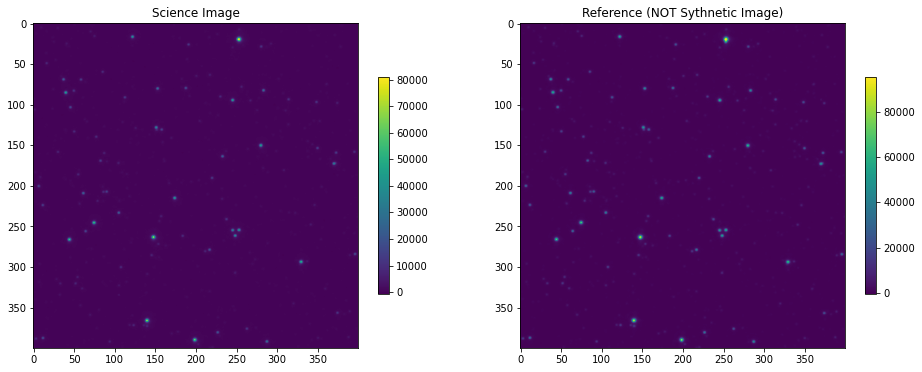

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 6
labels: [1 2 3 4 5 6]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[0.8, 51.6], [0.0, 57.5], [26.142857142857142, 44.285714285714285], [40.1, 4.8], [48.0, 1.9189189189189189], [53.857142857142854, 4.5]]
distance debug: 30 0.8 30 51.6 1319.2
1 1319.2 1656.25 1
2 1319.2 218.95918367346937 1
3 218.95918367346937 737.05 3
4 218.95918367346937 1112.5471146822497 3
5 218.95918367346937 1219.4132653061224 3
dumb counts....: 1916.5651588686042  on source 3 with gain: 4.0
area... 7 total noise... 449.9033616882855


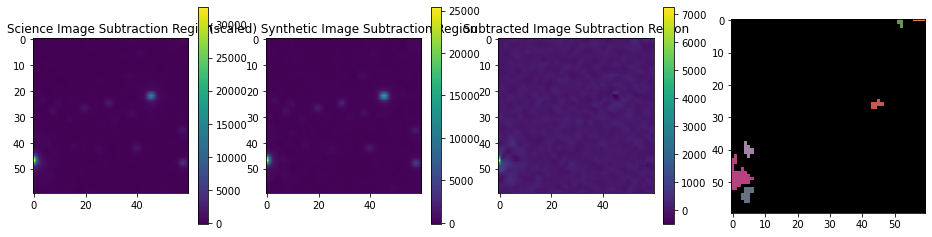

Saturation level on Science: 39974.2533542
Executing command: source-extractor SUM_Aligned_20230924_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39974.2533542 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  610 , 610  (for debug, should be the same!)
Filtered down to length: 491
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20230924_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  564 , 564  (for debug, should be the same!)
Filtered down to length: 453


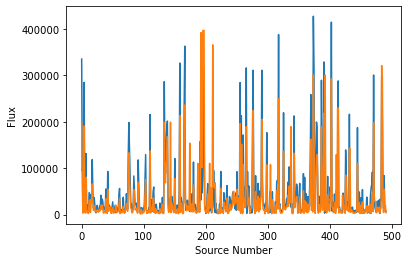

removing... (array([  2, 164, 466]),)


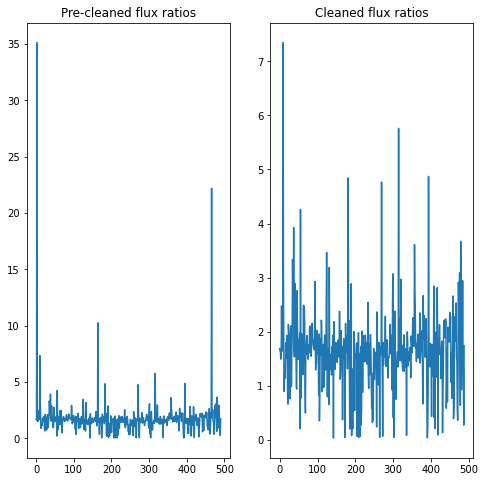

The scaling factor is 1.6376604593051505 average: 1.6271490924372671  deivation 0.742400542362932
Alignment offsets: -0.3499999999999943 0.3499999999999943 0.0 0.0
The center of the image is at:  205.74023107640625 198.50861220729243


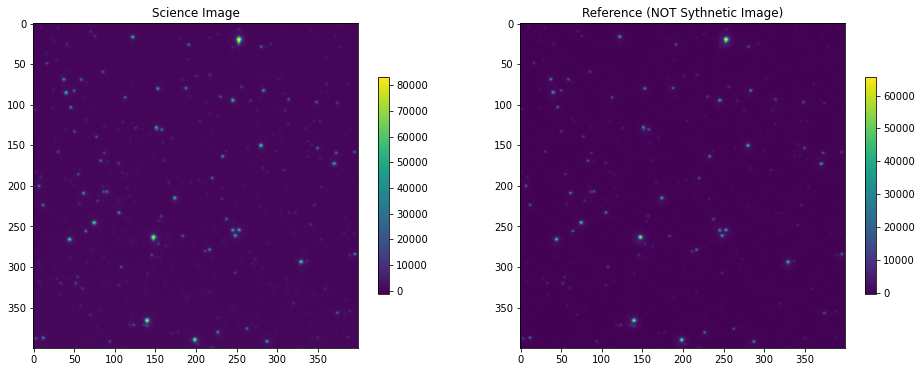

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 8
labels: [1 2 3 4 5 6 7 8]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[21.625, 45.75], [24.5, 29.0], [25.666666666666668, 45.666666666666664], [26.333333333333332, 19.666666666666668], [34.8, 57.6], [47.2, 57.5], [49.42857142857143, 0.8571428571428571], [48.333333333333336, 4.666666666666667]]
distance debug: 26.142857142857142 21.625 44.285714285714285 45.75 22.55516581632653
1 22.55516581632653 236.3520408163265 1
2 22.55516581632653 2.133786848072557 1
3 2.133786848072557 606.1337868480724 3
4 2.133786848072557 252.21632653061226 3
5 2.133786848072557 618.0206122448981 3
6 2.133786848072557 2428.2653061

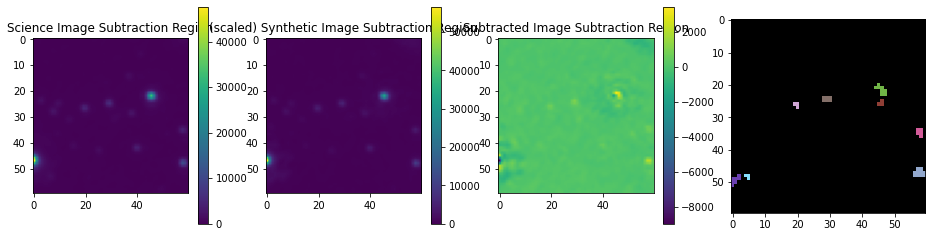

Saturation level on Science: 40099.82762688
Executing command: source-extractor SUM_Aligned_20230925_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40099.82762688 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  605 , 605  (for debug, should be the same!)
Filtered down to length: 486
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20230925_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  602 , 602  (for debug, should be the same!)
Filtered down to length: 484


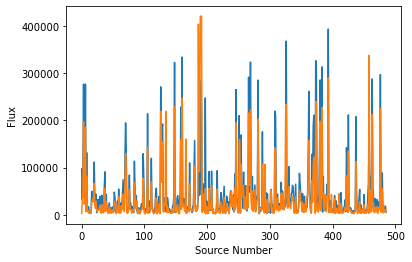

removing... (array([  0, 156, 198, 457, 459]),)


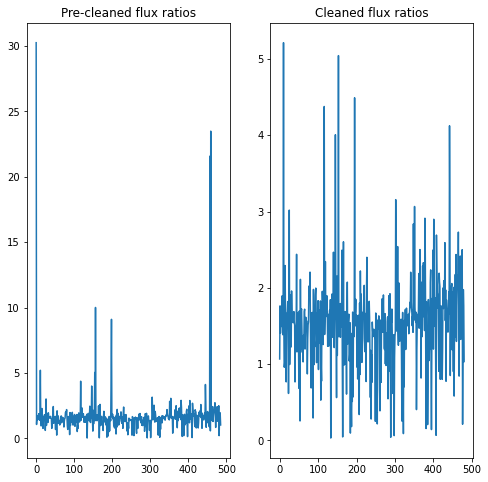

The scaling factor is 1.568065682882271 average: 1.5347236798372619  deivation 0.6167706526273598
Alignment offsets: -0.5500000000000114 0.75 0.0 0.0
The center of the image is at:  205.74023107640625 198.50861220729243


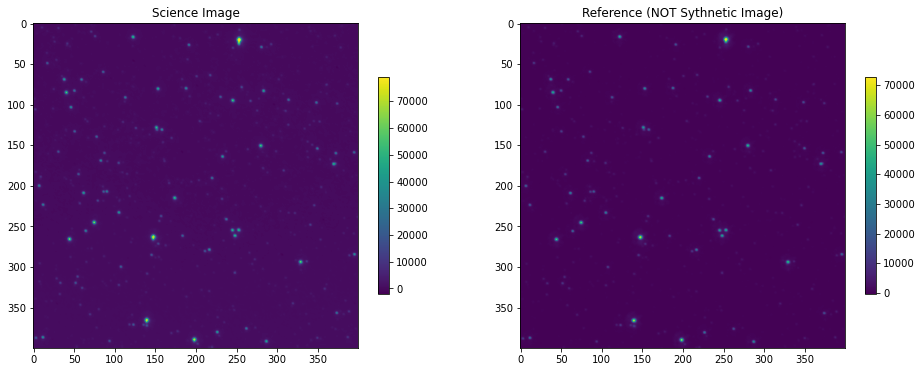

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 7
labels: [1 2 3 4 5 6 7]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[0.0, 57.0], [25.2, 28.6], [26.0, 44.0], [35.5, 56.5], [42.0, 39.285714285714285], [47.42857142857143, 7.714285714285714], [47.714285714285715, 57.0]]
distance debug: 25.666666666666668 0.0 45.666666666666664 57.0 787.2222222222223
1 787.2222222222223 291.48888888888877 1
2 291.48888888888877 2.88888888888888 2
3 2.88888888888888 214.05555555555557 3
4 2.88888888888888 307.4943310657595 3
5 2.88888888888888 1913.9637188208615 3
6 2.88888888888888 614.5419501133787 3
dumb counts....: 1411.9647296582034  on source 3 with gain: 4.0
area... 3 

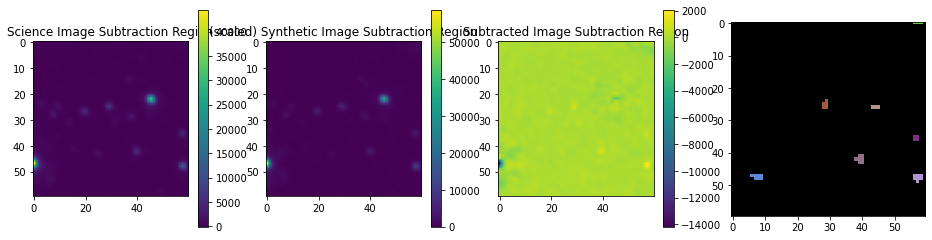

Saturation level on Science: 40025.77308729
Executing command: source-extractor SUM_Aligned_20230926_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40025.77308729 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  569 , 569  (for debug, should be the same!)
Filtered down to length: 456
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20230926_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  588 , 588  (for debug, should be the same!)
Filtered down to length: 473


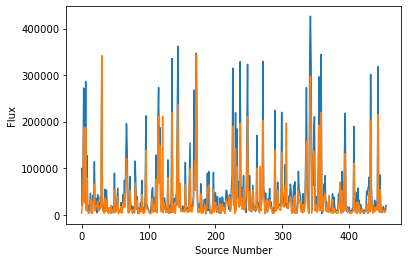

removing... (array([  0, 140, 428]),)


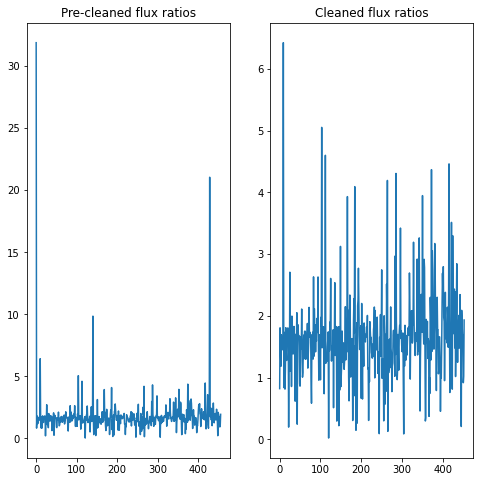

The scaling factor is 1.6311986980112771 average: 1.6508244285169482  deivation 0.707313816402004
Alignment offsets: -0.15000000000000568 0.25 0.0 0.0
The center of the image is at:  205.74023107640625 198.50861220729243


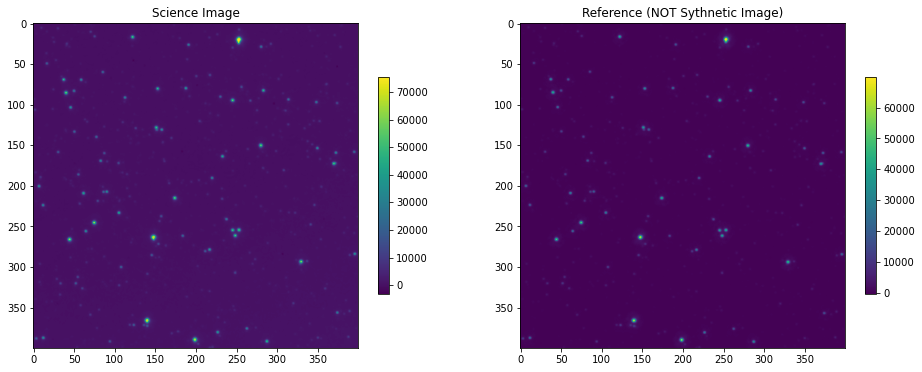

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 7
labels: [1 2 3 4 5 6 7]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[0.0, 57.5], [23.25, 44.82142857142857], [34.333333333333336, 57.333333333333336], [42.0, 39.5], [44.666666666666664, 0.3333333333333333], [47.125, 57.125], [49.0, 1.9375]]
distance debug: 26.0 0.0 44.0 57.5 858.25
1 858.25 8.23724489795918 1
2 8.23724489795918 247.2222222222223 2
3 8.23724489795918 276.25 2
4 8.23724489795918 2255.2222222222217 2
5 8.23724489795918 618.53125 2
6 8.23724489795918 2298.25390625 2
dumb counts....: 33340.97003409363  on source 2 with gain: 4.0
area... 28 total noise... 2762.7131928574145


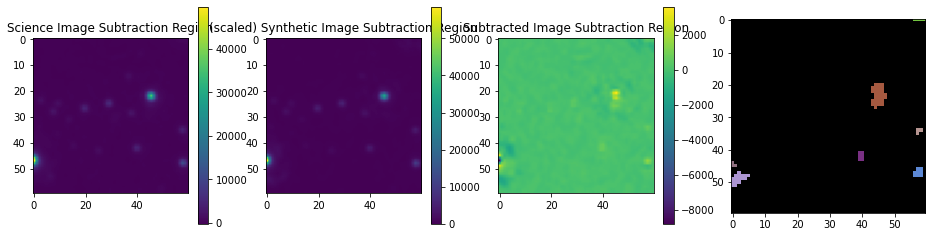

Saturation level on Science: 40082.02577786
Executing command: source-extractor SUM_Aligned_20230928_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40082.02577786 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  485 , 485  (for debug, should be the same!)
Filtered down to length: 387
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20230928_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  607 , 607  (for debug, should be the same!)
Filtered down to length: 491


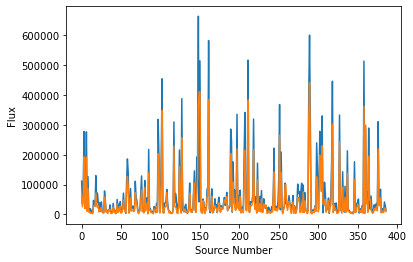

removing... (array([ 91, 122, 235, 300, 301, 319, 359]),)


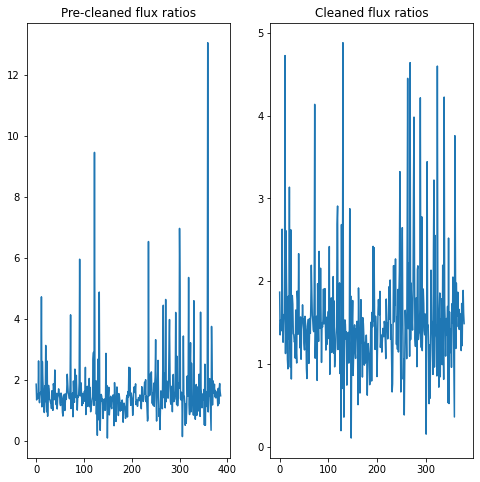

The scaling factor is 1.451206088174986 average: 1.5478044643015787  deivation 0.6741227521288433
Alignment offsets: 0.05000000000001137 -0.05000000000001137 0.0 0.0
The center of the image is at:  205.74023107640625 198.50861220729243


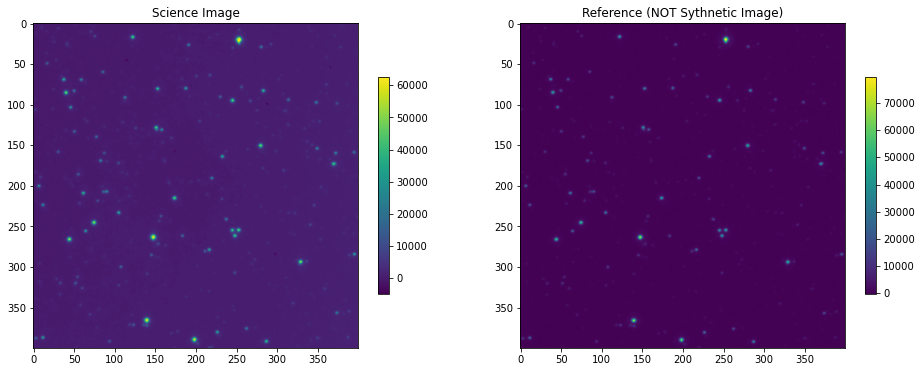

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 4
labels: [1 2 3 4]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[0.6, 57.2], [25.41176470588235, 44.705882352941174], [47.96153846153846, 1.6923076923076923], [51.6, 56.8]]
distance debug: 23.25 0.6 44.82142857142857 57.2 666.251530612245
1 666.251530612245 4.686577572205347 1
2 4.686577572205347 2470.781200941915 2
3 4.686577572205347 947.2086734693878 2
dumb counts....: 10494.367117061787  on source 2 with gain: 4.0
area... 17 total noise... 1710.5414575203874


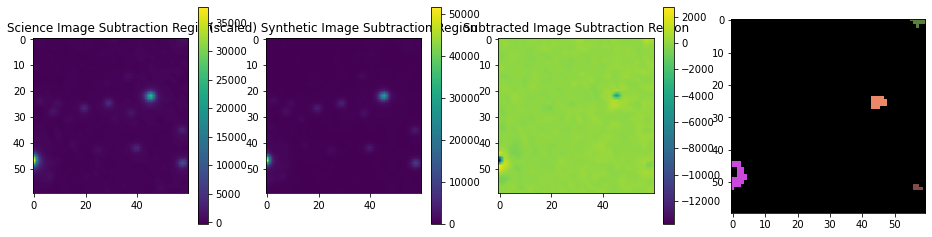

Saturation level on Science: 40066.66018009
Executing command: source-extractor SUM_Aligned_20230929_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 40066.66018009 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  504 , 504  (for debug, should be the same!)
Filtered down to length: 395
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20230929_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  657 , 657  (for debug, should be the same!)
Filtered down to length: 532


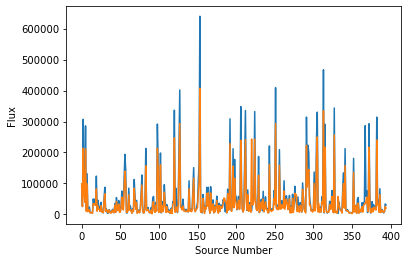

removing... (array([ 91, 122, 367]),)


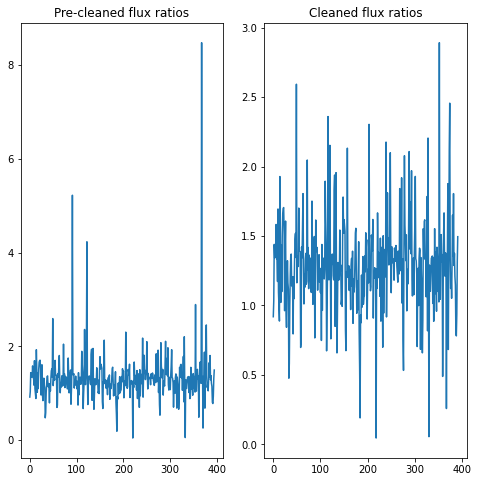

The scaling factor is 1.2912050252459466 average: 1.2855019904425398  deivation 0.34085379350003614
Alignment offsets: 0.05000000000001137 -0.3499999999999943 0.0 0.0
The center of the image is at:  205.74023107640625 198.50861220729243


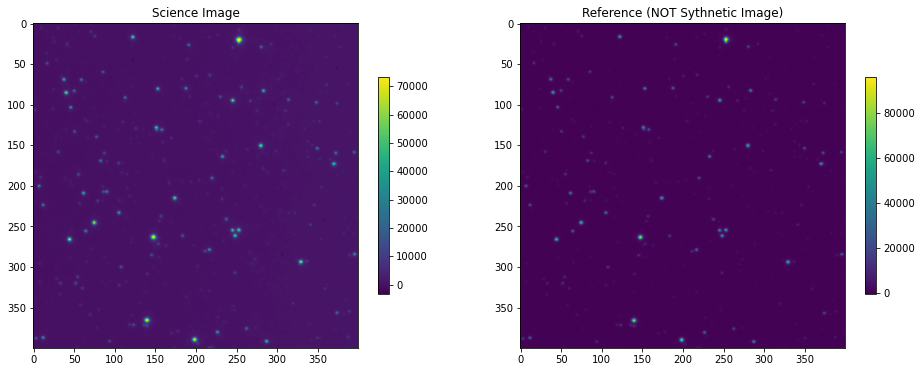

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 4
labels: [1 2 3 4]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[0.4444444444444444, 57.22222222222222], [24.142857142857142, 43.857142857142854], [23.166666666666668, 48.833333333333336], [47.888888888888886, 2.1333333333333333]]
distance debug: 25.41176470588235 0.4444444444444444 44.705882352941174 57.22222222222222 780.0258447605622
1 780.0258447605622 2.3304851352305613 1
2 2.3304851352305613 22.076316801230323 2
3 2.3304851352305613 2317.64304156521 2
dumb counts....: 19922.28287782128  on source 2 with gain: 4.0
area... 28 total noise... 2548.3199055007553


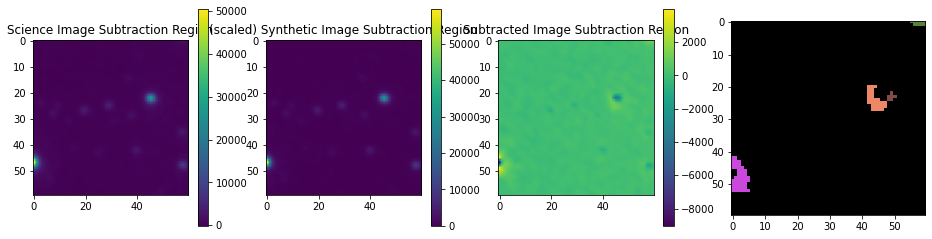

Saturation level on Science: 39958.93819679
Executing command: source-extractor SUM_Aligned_20231002_R_bkgsub_conv.fits -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39958.93819679 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  624 , 624  (for debug, should be the same!)
Filtered down to length: 500
Saturation level on Reference 39938.6679459
Executing command: source-extractor SUM_Aligned_20231002_R_bkgsub_refconv.fits -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL 39938.6679459 -DETECT_THRESH 2 -CATALOG_TYPE=ASCII_HEAD

Success!
Initial catalog length:  647 , 647  (for debug, should be the same!)
Filtered down to length: 521


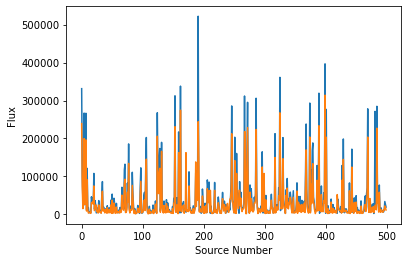

removing... (array([ 11, 109, 168, 269, 383, 481]),)


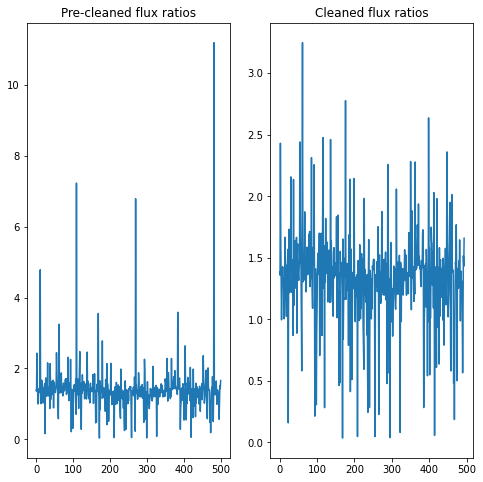

The scaling factor is 1.3680123343924988 average: 1.335022226685409  deivation 0.3906505286372305
Alignment offsets: -0.15000000000000568 -0.15000000000000568 0.0 0.0


The center of the image is at:  205.74023107640625 198.50861220729243


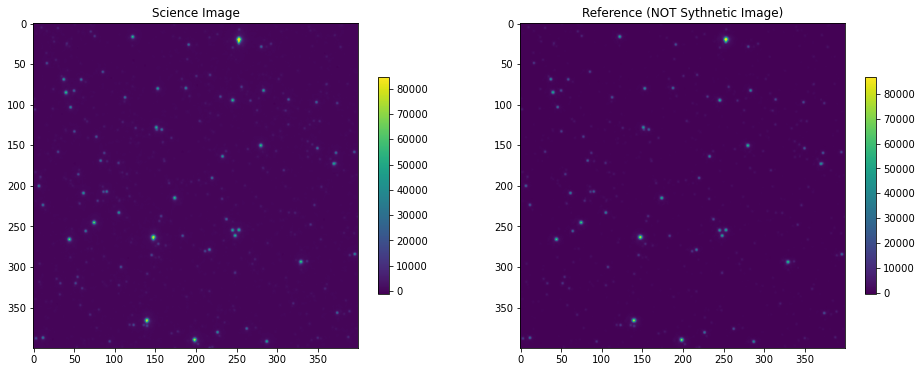

<photutils.segmentation.core.SegmentationImage>
shape: (60, 60)
nlabels: 6
labels: [1 2 3 4 5 6]
[[0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]]
sources found at barycenters: [[0.5, 57.5], [14.5, 48.5], [25.8, 44.5], [39.77777777777778, 1.4444444444444444], [50.125, 0.625], [55.333333333333336, 4.666666666666667]]
distance debug: 24.142857142857142 0.5 43.857142857142854 57.5 745.1122448979593
1 745.1122448979593 114.54081632653063 1
2 114.54081632653063 3.1593877551020486 2
3 3.1593877551020486 2043.2877299067773 3
4 3.1593877551020486 2544.0899234693875 3
5 3.1593877551020486 2508.7392290249436 3
dumb counts....: 5586.53321876146  on source 3 with gain: 4.0
area... 10 total noise... 881.5437621264389


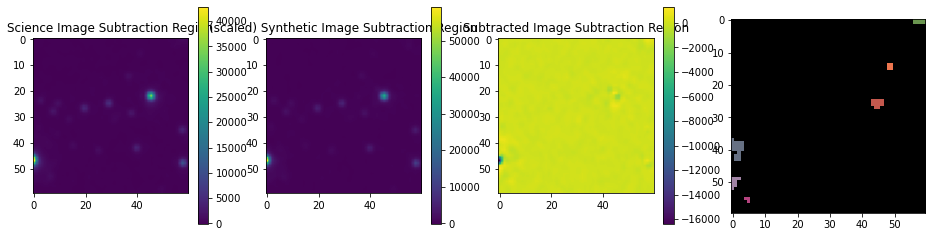

In [31]:
# We wrote a routine to filter the catalogs before normalization to remove flagged sources (generally saturated or
# other bad things) but that did not seem to improve the situation here (sse), so we are giving up! Change this flag
#if you like, but no evidence that it actually helps!
#filter_cat_flag=1
# in theoutlier elimination, also - reduced the spread over the normalization, but didn't actually improve
# the resulting images! arg! This gives a 3 sigma filter on the flux ratios.
#eliminate_outliers_flag=1
#show_images_flag=1
sub_array=[]
phot_cat=[]
#for i in range(len(bkg_subtract_array)-1): 
for i in range(len(sci_conv_array)): # changed this line!
    
    # on dpj some of the galaxy core was left after subtraction, so going to add the saturation
    # keyword to the source extractor, so maybe it will skip some bright sources and the normalization
    # will be better....nope, this did not work!
    sci_image = fits.open(sci_conv_array[i])
    
    
    
    SAT=sci_image[0].header['SATURATE']
    print("Saturation level on Science:",SAT)
    # Run SExtractor on the science image
    if os.path.exists('sci_match.cat'): #Remove possible temporary files - don't think I actually need this!
        os.remove("sci_match.cat") 
    # watch the order on these parameters, apparently putting saturation at the end dooesn't work!
    # NOte these are explicitly being done as ASCII!
    
    
    sextractor_command = "source-extractor %s -c prepsfex.sex -CATALOG_NAME sci_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL %s -DETECT_THRESH %s -CATALOG_TYPE=ASCII_HEAD" % (sci_conv_array[i],SAT,extract_thresh)
   
    try:
        command = sextractor_command
        print('Executing command: %s\n' % command)
        #command = "source-extractor %s -c %s -CATALOG_NAME %s -MAG_ZEROPOINT 25.0 -SATUR_LEVEL %s" % (sci_conv_array[i], \
        #os.path.join(data_dir,'prepsfex.sex'), os.path.join(proc_dir, 'sci_match.cat'),SAT)
        rval = subprocess.run(command.split(), check=True)
        print('Success!')
    except subprocess.CalledProcessError as err:
        print('Could not run SExtractor with exit error %s'%err)

    if (filter_cat_flag==1): clean_cat("sci_match.cat")
    cat_sci = ascii.read('sci_match.cat') # dummy, should be able to rewrite constantly
    
    ref_image = fits.open(ref_conv_array[i])
    SAT=ref_image[0].header['SATURATE']
    print("Saturation level on Reference",SAT)
    # Run SExtractor on the reference image
    sextractor_command = "source-extractor %s -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -SATUR_LEVEL %s -DETECT_THRESH %s -CATALOG_TYPE=ASCII_HEAD" % (ref_conv_array[i],SAT,extract_thresh)
    #sextractor_command = "source-extractor %s -c prepsfex.sex -CATALOG_NAME ref_match.cat -MAG_ZEROPOINT 25.0 -CATALOG_TYPE=ASCII_HEAD" % (ref_conv_array[i])
    
    try:
        command = sextractor_command
        print('Executing command: %s\n' % command)
        rval = subprocess.run(command.split(), check=True)
        print('Success!')
    except subprocess.CalledProcessError as err:
        print('Could not run SExtractor with exit error %s'%err)

    # Read in the SExtractor output catalog
    if (filter_cat_flag==1): clean_cat("ref_match.cat")
    cat_ref = ascii.read('ref_match.cat')
    
    # Match the catalog of sources of the reference and science images.  
    # Calculate the ratio between the flux of source in the science image over the flux of sources 
    # in the reference image.
    
    c_sci = SkyCoord(ra=cat_sci['X_WORLD'], dec=cat_sci['Y_WORLD'])
    c_ref = SkyCoord(ra=cat_ref['X_WORLD'], dec=cat_ref['Y_WORLD'])

    # I think idx is the index of c_ref that each c_sci matches into.
    idx, d2d, d3d = c_sci.match_to_catalog_3d(c_ref)

    # Initialize a list for the indexes and one for the flux ratios
    # for each (sci, ref) pair, don't need to save all this?
    index_arr = []
    ratio_arr = []

    # for debugging
    sci_list=[]
    ref_list=[]
    
    # Sure don't need to be printing all this stuff! Is there a final normalization i can use for checking?
    for j, i2, d in zip(idx, np.arange(len(d2d)),d2d):
        #print(i,d)
        #index_arr.append(i)
        
        # for debugging #
        #print("Image coordinates | separation")
        #print(cat_ref['X_IMAGE'][j],cat_ref['Y_IMAGE'][j],'  ', cat_sci['X_IMAGE'][i2],cat_sci['Y_IMAGE'][i2],d)
        #print('Fluxes and flux ratio')
        #print(cat_ref['FLUX_AUTO'][j], cat_sci['FLUX_AUTO'][i2],'                  ', cat_sci['FLUX_AUTO'][i2] / cat_ref['FLUX_AUTO'][i])
        ##
        
        # For debugging
        sci_list.append(cat_sci['FLUX_AUTO'][i2])
        ref_list.append(cat_ref['FLUX_AUTO'][j])
        
        ratio_arr.append(cat_sci['FLUX_AUTO'][i2] / cat_ref['FLUX_AUTO'][j]) # Ratio of SCI/REF!
    
    if (show_images_flag==1):
        plt.xlabel('Source Number')
        plt.ylabel('Flux')
        plt.plot(sci_list)
        plt.plot(ref_list)
        plt.show()
    
    #
    # Current thought is the issue is here - the median vs mean of the scaling factors are vastly
    # different (factor of 4) as opposed to the case for dpj, when they are like 0.9-1.1. 
    # Maybe going back and carrying around a correct value of the saturate keyword will help?
    # another alternative is to go back to the background of the reference image - it's just worse!
    #
    
    
    if (eliminate_outliers_flag==1):
        fig, axs = plt.subplots(1, 2,figsize=(8,8))
        im0=axs[0].set_title('Pre-cleaned flux ratios')
        im0=axs[0].plot(ratio_arr)
        remove = np.where(ratio_arr>np.average(ratio_arr)+3*np.std(ratio_arr))
        print("removing...",remove)
        ratio_arr = np.delete(ratio_arr, remove)
        #for i in reversed(range(len(ratio_arr))): # this should go backward...
        #    print(ratio_arr[i],np.average(ratio_arr),np.std(ratio_arr))
        #    if ( ratio_arr[i]>np.average(ratio_arr)+3*np.std(ratio_arr) ) or ( ratio_arr[i]<np.average(ratio_arr)-3*np.std(ratio_arr) ):
        #        print("eliminating ratio:", ratio_arr[i])
        #        ratio_arr[i].remove()
        im1=axs[1].set_title('Cleaned flux ratios')
        im1=axs[1].plot(ratio_arr)
        plt.show()
    
    scale = np.median(ratio_arr)
    #scale=np.average(ratio_arr) # changing to average didn't seem to help
    print("The scaling factor is", scale,"average:",np.average(ratio_arr)," deivation",np.std(ratio_arr))
    
    # plotting for evaluation
    #plt.hist(ratio_arr)
    #plt.show()
    
    # fine tune the alignment here - at least without this, the alginment is terrible!
    #sci_image = fits.open(sci_conv_array[i])
    #ref_image = fits.open(ref_conv_array[i])
    
    # For testing alignment on koy
    #xoff, yoff, exoff, eyoff = chi2_shift(ref_image[0].data, sci_image[0].data, 10, return_error=True, upsample_factor='auto')
    # errors are just flat zeros here, so not likely they are being calculated carefully.
    # no, those zeros are found in other sources as well...
    xoff, yoff, exoff, eyoff = chi2_shift(ref_image[0].data, sci_image[0].data, 10, return_error=True, upsample_factor=10)
    print("Alignment offsets:",xoff,yoff,exoff,eyoff)
    sci_image_shift = scipy.ndimage.shift(sci_image[0].data, [-yoff, -xoff], order=3, mode='reflect', cval=0.0, prefilter=True)
 
    # Create an empty image with the reference image in a square in the center.
    # "synthetic image"
    #RA=128.249
    #Dec=-27.449311
    coord = SkyCoord(RA,Dec,unit='deg')
    w = WCS(sci_image[0].header)
    x, y = w.world_to_pixel(coord)
    print("The center of the image is at: ",x,y)

    # The synthetic image will be an image that starts with zeros everywhere, but with the windowed reference image
    # at the center.
    synthetic_image=np.zeros(sci_image[0].data.shape) 
    synthetic_image[int(y)-window:int(y)+window,int(x)-window:int(x)+window]=ref_image[0].data[int(y)-window:int(y)+window,int(x)-window:int(x)+window]
    
    # Do we need to plot the science and reference image here, as part of the debug?
    if (show_images_flag==1):
        fig, axs = plt.subplots(1, 2,figsize=(16,16))
        im0=axs[0].set_title('Science Image')
        im0=axs[0].imshow(sci_image_shift)
        fig.colorbar(im0,ax=axs[0],shrink=0.25)
        im1=axs[1].set_title('Reference (NOT Sythnetic Image)')
        im1=axs[1].imshow(ref_image[0].data)
        fig.colorbar(im1,ax=axs[1],shrink=0.25)
        plt.show()
    
    # image subtraction step
    # Rescale the reference image to the science and perform the image subtraction.
    image_sub=sci_image_shift-synthetic_image*scale
    
    
    # Stick a photometry step in here!
    # some of this is just wasted for now, but I do need the segment maps for the *real* calculation!
    # segment image version first, but I think circular aperature is more defensible.
    # Parameters here seems *very* sensitive to details of the analysis.
    nsig=3 # sigma over the background for detection
    npix=3 # minimun number of connected pixels
    conn=4 # 8: is surrouding 8 for connectivity, 4 is surroudning 4
    nlev=100 # levels of threshold division for deblending.
    # Background subtraction
    sub_cutout=image_sub[int(y)-window:int(y)+window,int(x)-window:int(x)+window]
    bkg_estimator = MedianBackground()
    bkg = Background2D(sub_cutout, (window, window), filter_size=(3, 3),bkg_estimator=bkg_estimator)
    sub_cutout -= bkg.background
    # error estimate - this is probably wrong, I think it needs to be the gain from the CCD, since our units are
    # counts, not cts/s!
    effective_gain = 900 #exposure time - needs to be changed for each exposure!
    error = calc_total_error(sub_cutout, bkg.background_rms, effective_gain)
        
        
    # my exception got trashed here, need to deal with the "none" response from detect_sources.    
    sigma_clip = SigmaClip(sigma=5, maxiters=20) # parameters for estimation
    threshold = detect_threshold(sub_cutout, nsigma=nsig, sigma_clip=sigma_clip)
    segment_map = detect_sources(sub_cutout, threshold, npixels=npix,connectivity=conn)
    print(segment_map)
    if i==0 : last_source_bary=[window,window] # needs to be outside of the loop in case the first one is skipped.
    if segment_map!=None:
        # deblending is tricky...
        segm_deblend = deblend_sources(sub_cutout, segment_map,npixels=npix, nlevels=nlev, contrast=0.001,progress_bar=False)
        cat = SourceCatalog(sub_cutout, segm_deblend,background=bkg.background, error=error)
        tbl = cat.to_table()
    
        # I have serious doubts about that catalog function, so this will just add up the counts in each pixels
        # we've decided counts as a source.
        print(segment_map.data[14:26,14:26])
        #if i==0 : last_source_bary=[window,window] # hopefully the right source in the first cutout is at the center!!
        source_index,last_source_bary=find_source_index(segment_map,last_source_bary)
        counts=0
        pix_area=0
        for j in range(len(sub_cutout)):
            for k in range(len(sub_cutout[j])):
                if segment_map.data[j][k] == source_index :
                    counts += sub_cutout[j][k]
                    pix_area += 1
        print("dumb counts....:", counts," on source",source_index, "with gain:",sci_image[0].header['ARAWGAIN'])
        # convert to instrumental magnitudes and store...
        noise=np.mean(bkg.background_rms)*pix_area #background over pixel areas, rms because many were negative...do I need gain?
        print("area...",pix_area,"total noise...",noise)
        mag_shift=30 # totally arbitrary...
        inst=-2.5*math.log(counts*sci_image[0].header['ARAWGAIN'])
        err_inst=-2.5*math.log(1+noise/counts)
        phot_cat.append([sci_image[0].header['MJD-OBS'], last_source_bary,counts,noise,mag_shift+inst,abs(err_inst)]) # modified julian date at start of observation
    
    else:
        print("Sources not found, setting segment map to zero")
        segment_map=SegmentationImage(np.zeros(sub_cutout.shape,dtype=int))
        segm_deblend=SegmentationImage(np.zeros(sub_cutout.shape,dtype=int))
    #plot step for evaluation
    # JEsus christ, we have to get the titles in before the imshow command or the colorbar doens't know what to do!
    fig, axs = plt.subplots(1, 4,figsize=(16,16))
    im0=axs[0].set_title('Science Image Subtraction Region')
    im0=axs[0].imshow(sci_image_shift[int(y)-window:int(y)+window,int(x)-window:int(x)+window])
    fig.colorbar(im0,ax=axs[0],shrink=0.25)
    #plt.show()
    
    im1=axs[1].set_title('(scaled) Synthetic Image Subtraction Region')
    im1=axs[1].imshow(scale*synthetic_image[int(y)-window:int(y)+window,int(x)-window:int(x)+window])
    fig.colorbar(im1,ax=axs[1],shrink=0.25)
    #plt.show()
    
    im2=axs[2].set_title('Subtracted Image Subtraction Region')
    #x,y=w.world_to_pixel(coord)
    
    im2=axs[2].imshow(image_sub[int(y)-window:int(y)+window,int(x)-window:int(x)+window])
    #im2=axs[2].scatter(window, window, marker='o', color='r', facecolors='none',s=1000,linewidths=2)
    #axs[2].colorbar(shrink = 0.4)
    fig.colorbar(im2,ax=axs[2],shrink=0.25)
    
    im3=axs[3].imshow(segm_deblend, cmap=segment_map.cmap,interpolation='nearest')
    plt.show()
    #plt.tight_layout(h_pad=1)
    
    #image_sub=sci_image_shift-synthetic_image*scale
    hdu_image_sub = fits.PrimaryHDU(image_sub,sci_image[0].header) # header might need work!
    sub_array.append(sci_conv_array[i].replace(".fits","_diff.fits")) 
    hdu_image_sub.writeto("out/"+sub_array[i],overwrite=True) # move to the out directory
    


Text(0.5, 1.0, 'Title')

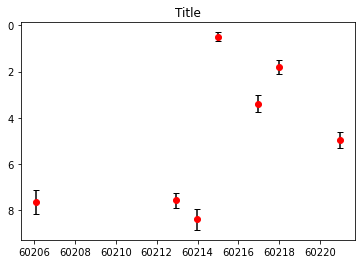

In [32]:
date=[row[0] for row in phot_cat]
mag=[row[4] for row in phot_cat]
err=[row[5] for row in phot_cat]
fig, ax = plt.subplots()
ax.errorbar(date, mag, yerr=err, capsize=3,fmt="ro",ecolor = "black")
ax.invert_yaxis()
ax.set_title("Title")

In [33]:
# write that bitch to a file for plotting with gnuplot
# Formatting just like aij!
# thanks chatGPT!
rows = zip(date, mag, err)

# Write to CSV
with open(output_file, "w", newline="") as f:
    writer = csv.writer(f, delimiter=" ")
    
    # Write header
    writer.writerow(["JD Date-24000000", "Magnitude", "Error"])
    
    # Write data rows
    writer.writerows(rows)

print("CSV file created:",output_file," don't forget to move it to the right place!")


CSV file created: row_Phot.csv  don't forget to move it to the right place!


Let's plot them all to get a good look, and also to get an initial flux estimate.

mean background: -1.538514977509636 total background: -309.33679045005687
 id      xcenter            ycenter          aperture_sum   aperture_sum_bkgsub
           pix                pix                                              
--- ------------------ ------------------ ----------------- -------------------
  1 205.74023107640625 198.50861220729243 608.3728042372336   917.7095946872905


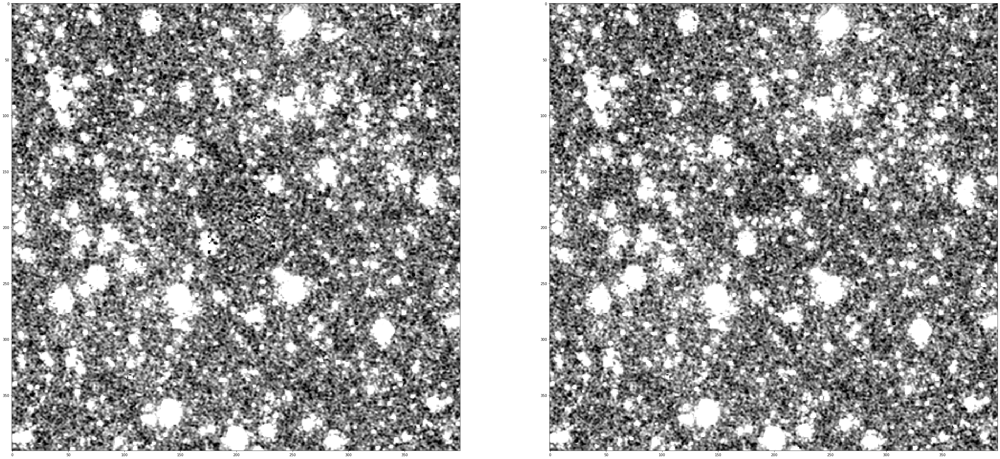

mean background: 24.216289778616666 total background: 4868.973956205038
 id      xcenter            ycenter          aperture_sum   aperture_sum_bkgsub
           pix                pix                                              
--- ------------------ ------------------ ----------------- -------------------
  1 205.74023107640625 198.50861220729243 6618.144518294518    1749.17056208948


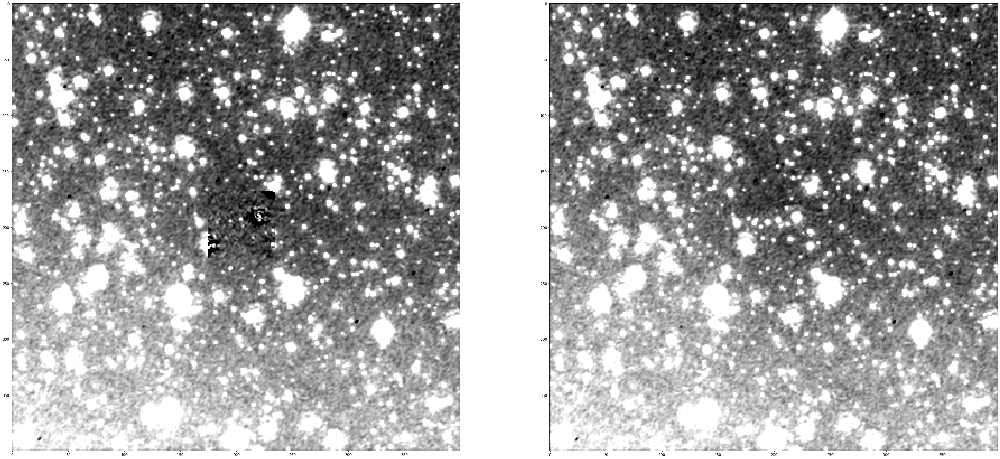

mean background: 1.8511433407421525 total background: 372.1944524811017
 id      xcenter            ycenter          aperture_sum   aperture_sum_bkgsub
           pix                pix                                              
--- ------------------ ------------------ ----------------- -------------------
  1 205.74023107640625 198.50861220729243 4665.432716299405  4293.2382638183035


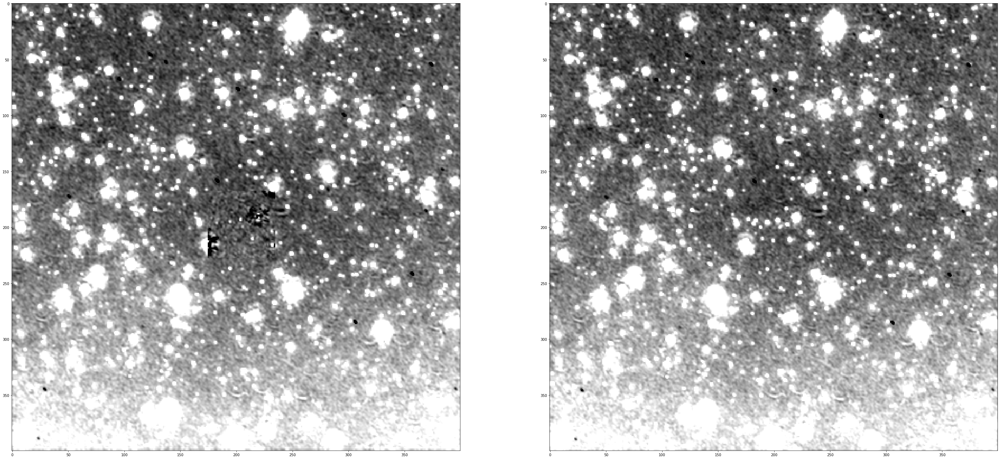

mean background: 20.62823216955525 total background: 4147.552168986843
 id      xcenter            ycenter          aperture_sum   aperture_sum_bkgsub
           pix                pix                                              
--- ------------------ ------------------ ----------------- -------------------
  1 205.74023107640625 198.50861220729243 5262.154592870137  1114.6024238832943


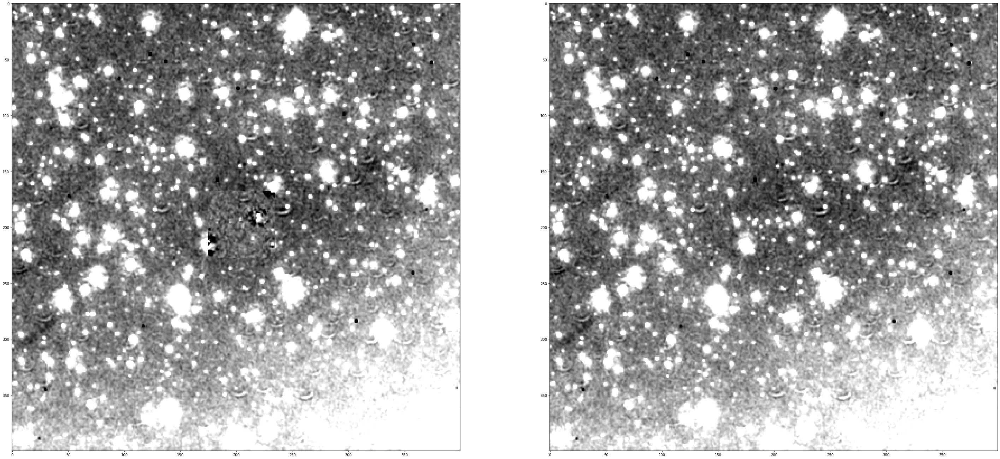

mean background: -9.637478123477822 total background: -1937.7299501984173
 id      xcenter            ycenter          aperture_sum   aperture_sum_bkgsub
           pix                pix                                              
--- ------------------ ------------------ ----------------- -------------------
  1 205.74023107640625 198.50861220729243 2228.302718468836   4166.032668667253


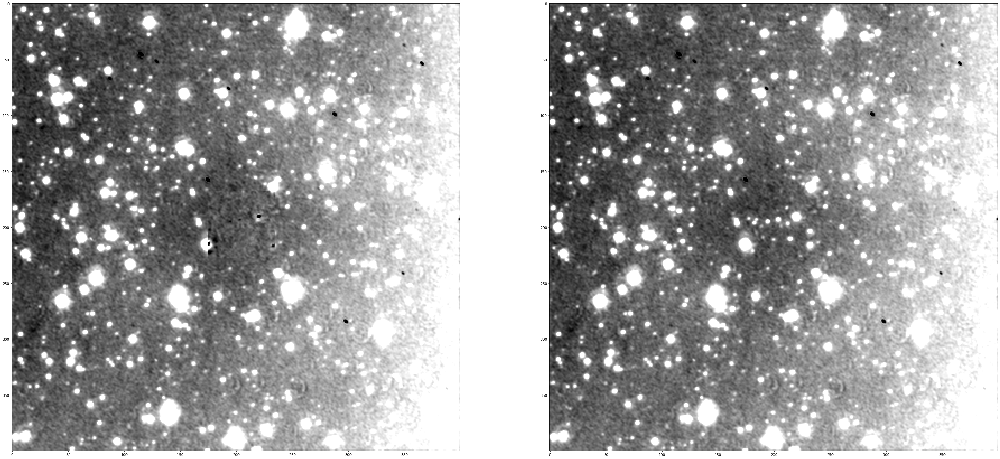

mean background: -9.394745790304507 total background: -1888.9257188585134
 id      xcenter       ...    aperture_sum    aperture_sum_bkgsub
           pix         ...                                       
--- ------------------ ... ------------------ -------------------
  1 205.74023107640625 ... -2891.246001324441 -1002.3202824659274


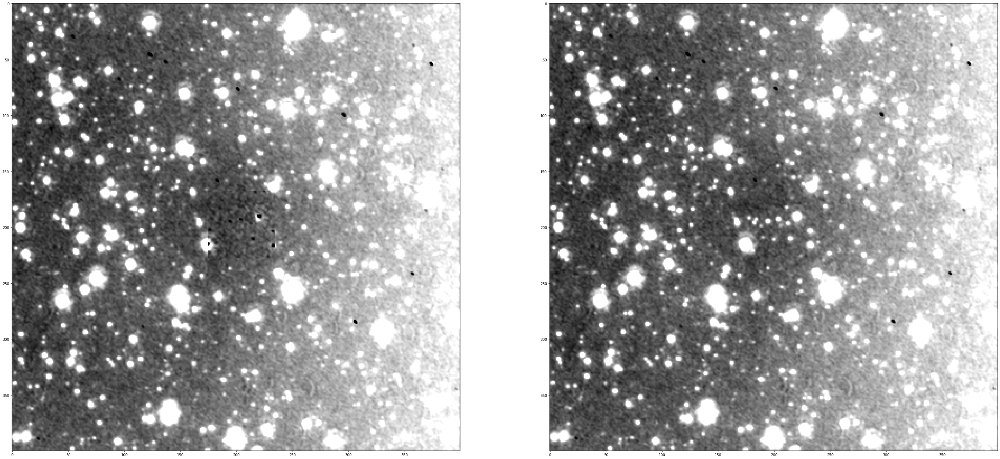

mean background: -0.6348175100736737 total background: -127.63763366512754
 id      xcenter            ycenter          aperture_sum   aperture_sum_bkgsub
           pix                pix                                              
--- ------------------ ------------------ ----------------- -------------------
  1 205.74023107640625 198.50861220729243 805.0753575281865    932.712991193314


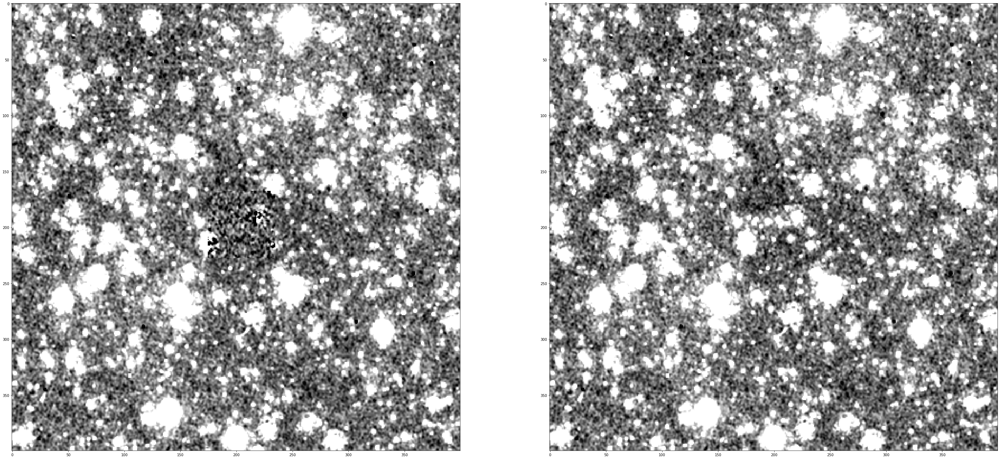

In [34]:
#fig, axs = plt.subplots(len(sci_conv_array), 2, figsize=(50,50)) # ugh figsize does nothing.
for i in range(len(sci_conv_array)):
    fig, axs = plt.subplots(1, 2, figsize=(50,50))
    sci_image = fits.open(sci_conv_array[i])
    sub_image = fits.open("out/"+sub_array[i])
    
    w = WCS(sub_image[0].header)
    #print(w)
    coord = SkyCoord(ra=RA * u.deg, dec=Dec * u.deg, frame='icrs')
    #print(coord)
    x,y=w.world_to_pixel(coord)
    #print(x,y)
    
    aper = CircularAperture((x,y), 8)
    annulus = CircularAnnulus((x,y), 16,25)
    aperstats = ApertureStats(sub_image[0].data, annulus)
    bkg_mean = aperstats.mean
    
    total_bkg = bkg_mean * aper.area
    print("mean background:", bkg_mean,"total background:",total_bkg)
    phot_table = aperture_photometry(sub_image[0].data, aper)
    #phot_table['aperture_sum'].info.format = '%.8g'  # for consistent table output
    
    phot_bkgsub = phot_table['aperture_sum'] - total_bkg
    phot_table['aperture_sum_bkgsub'] = phot_bkgsub
    print(phot_table)
    
    mean, median, std = sigma_clipped_stats(sub_image[0].data)
    #axs[0].plot(aper)
    #axs[0].scatter(x, y, marker='o', color='r', facecolors='none',s=1000,linewidths=2)
    axs[0].imshow(sub_image[0].data, vmin=median-2*std, vmax=median+2*std, cmap='gray')
        
    mean, median, std = sigma_clipped_stats(sci_image[0].data)
    axs[1].imshow(sci_image[0].data, vmin=median-2*std, vmax=median+2*std, cmap='gray')
    plt.show()